<a href="https://colab.research.google.com/github/Sanim27/GAN/blob/main/ConditionalGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

In [3]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels of the output image, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor,
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

In [4]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels of the output image, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN;
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor,
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

In [5]:
import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    return F.one_hot(labels, n_classes)

In [6]:
def combine_vectors(x, y):
    combined = torch.cat((x.float(), y.float()), dim=1)
    # By concatenating column wise. number of samples remain the same but the z_dim and n_classes are added.
    return combined

In [7]:
mnist_shape = (1, 28, 28)
n_classes = 10

In [8]:
# criterion = nn.BCEWithLogitsLoss()
# n_epochs = 200
# z_dim = 64
# display_step = 500
# batch_size = 128
# lr = 0.0002
# device = 'cuda'

# transform = transforms.Compose([
#     transforms.ToTensor(),
#     transforms.Normalize((0.5,), (0.5,)),
# ])

# dataloader = DataLoader(
#     MNIST('.', download=True, transform=transform),
#     batch_size=batch_size,
#     shuffle=True)
import time
import torch
import matplotlib.pyplot as plt

criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=True, transform=transform),
    batch_size=batch_size,
    shuffle=True)

In [9]:
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes
    #here discriminator must have 11 channels, 1 for image and 10 to determine which class the image is of. with all 1s or all 0s
    return generator_input_dim, discriminator_im_chan

In [10]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 500: Generator loss: 2.2362256524562834, discriminator loss: 0.24021935975924133


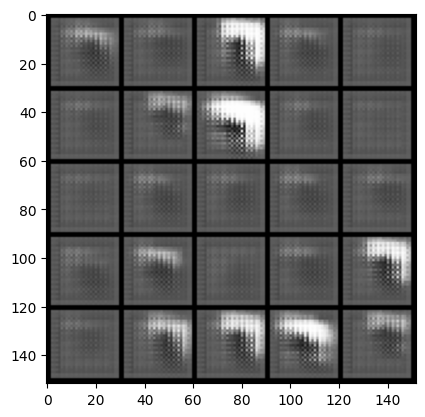

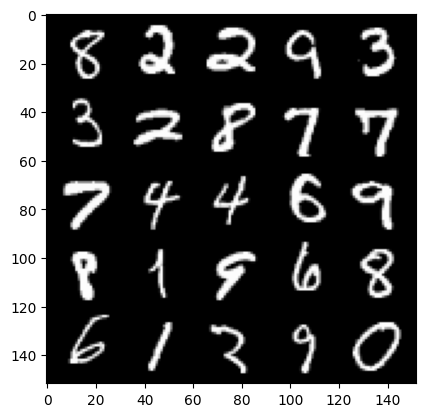

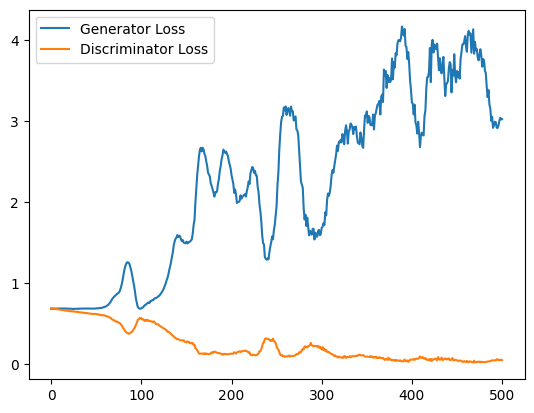

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1000: Generator loss: 4.3324594674110415, discriminator loss: 0.03936959048081189


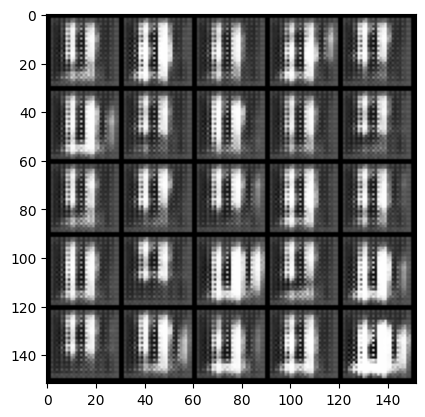

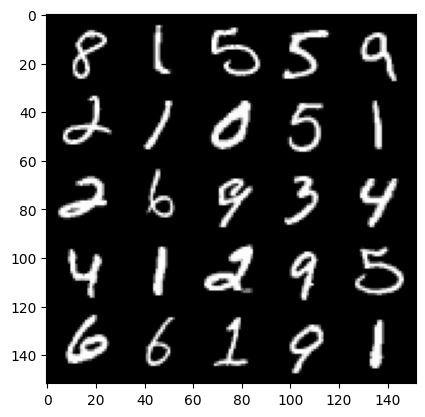

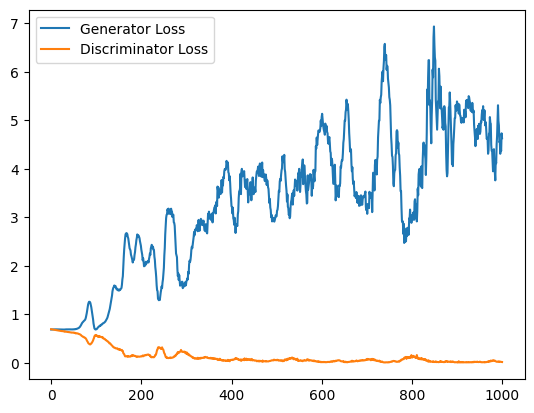

  0%|          | 0/469 [00:00<?, ?it/s]

Step 1500: Generator loss: 4.859930371284485, discriminator loss: 0.033935492331162095


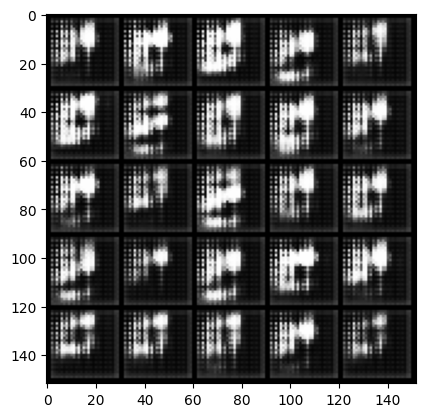

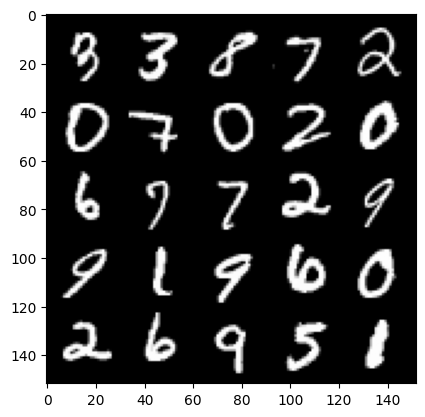

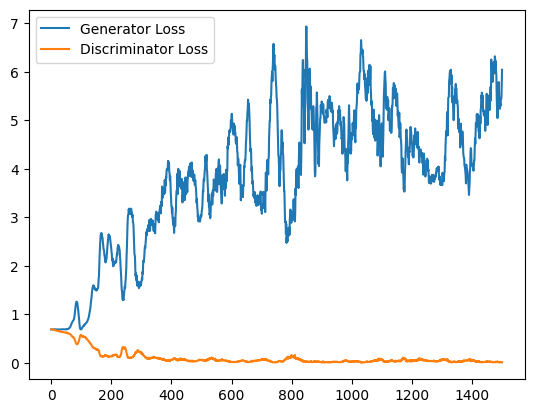

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2000: Generator loss: 4.986219439029694, discriminator loss: 0.02781415264448151


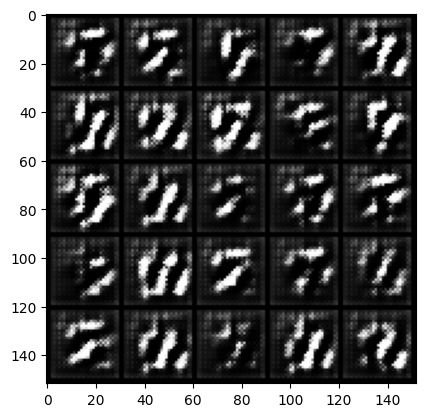

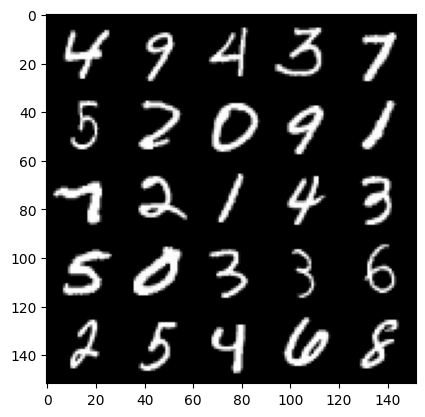

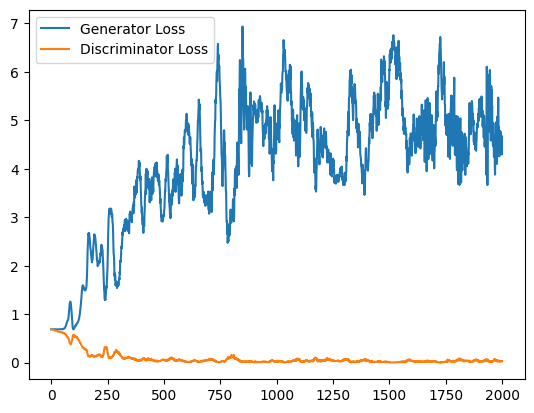

  0%|          | 0/469 [00:00<?, ?it/s]

Step 2500: Generator loss: 3.8654054856300353, discriminator loss: 0.09458889390900731


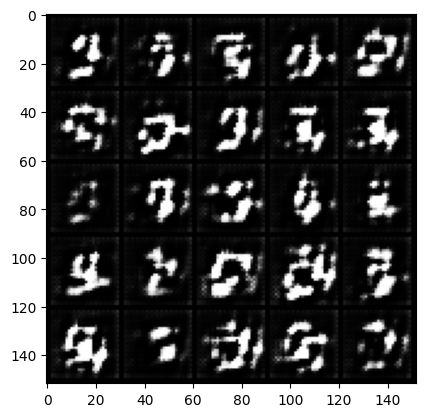

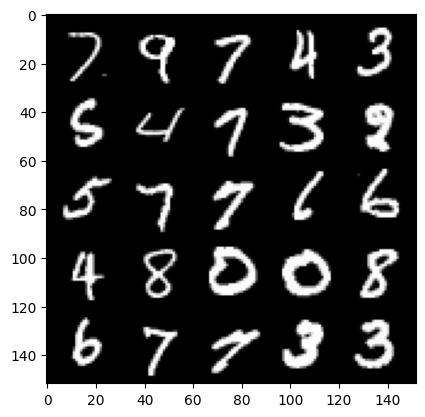

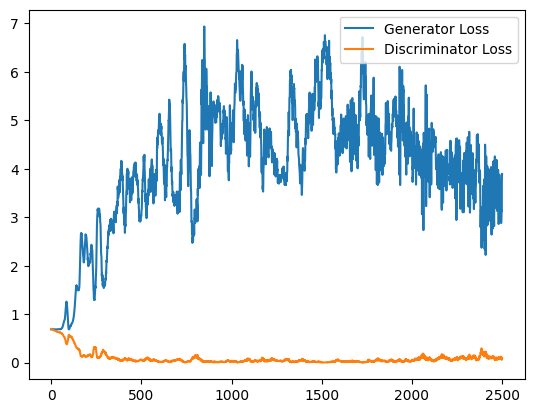

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3000: Generator loss: 2.995613308429718, discriminator loss: 0.17055899995565416


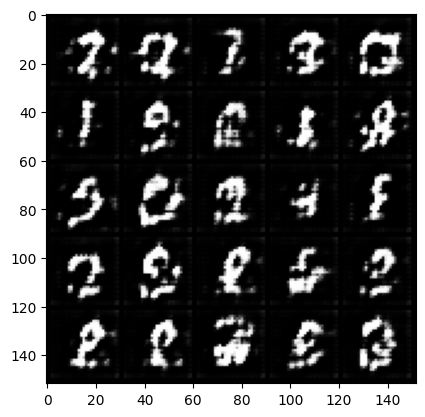

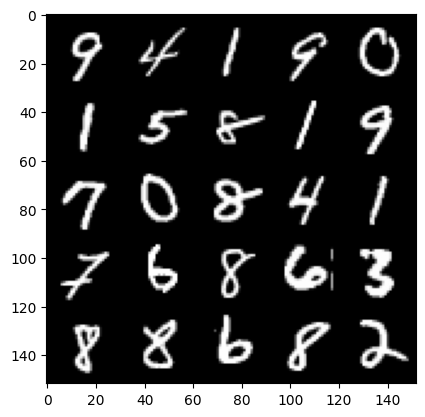

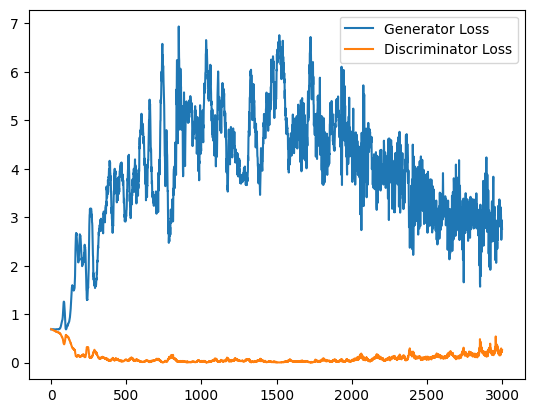

  0%|          | 0/469 [00:00<?, ?it/s]

Step 3500: Generator loss: 2.5596468570232394, discriminator loss: 0.26611033707857135


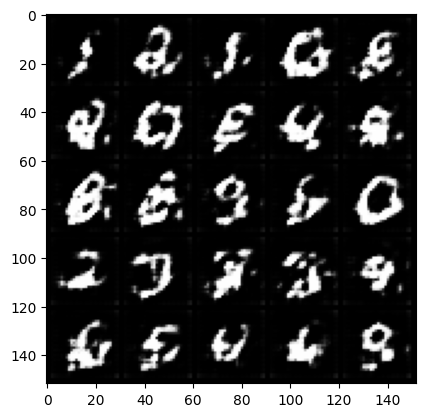

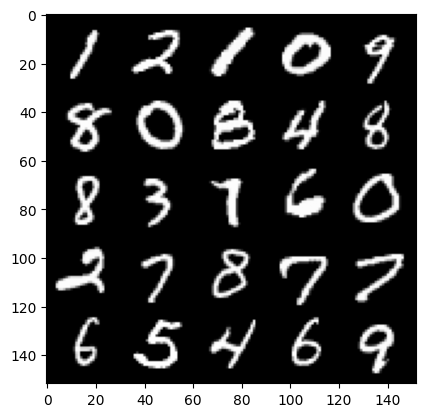

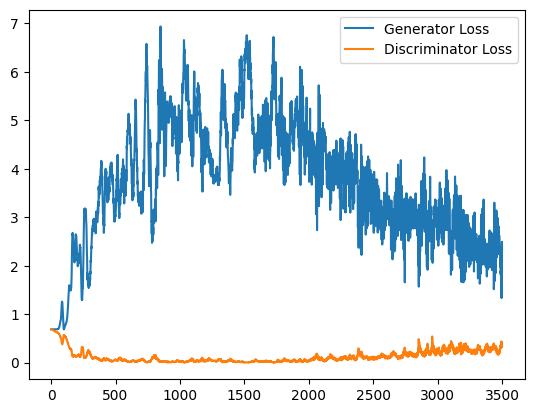

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4000: Generator loss: 2.227130367279053, discriminator loss: 0.307393853276968


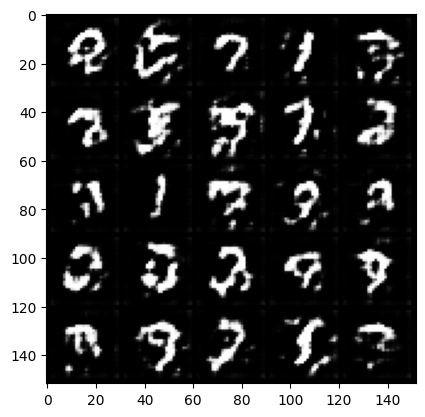

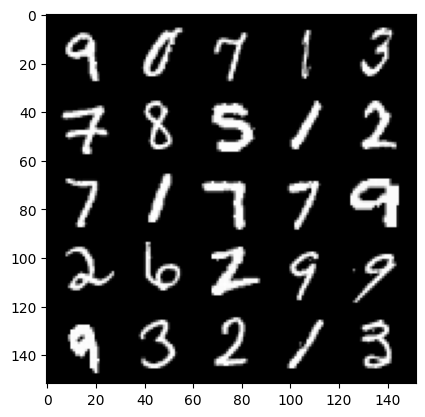

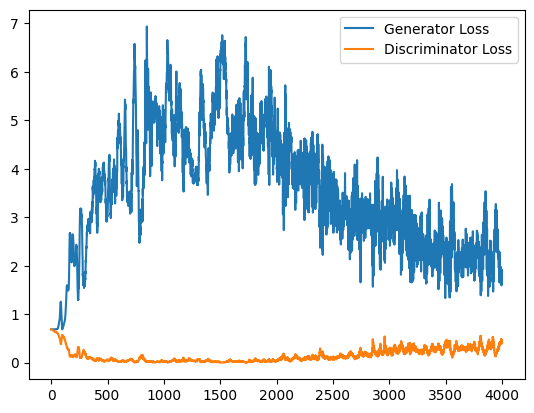

  0%|          | 0/469 [00:00<?, ?it/s]

Step 4500: Generator loss: 2.1056667883396147, discriminator loss: 0.30684158934652805


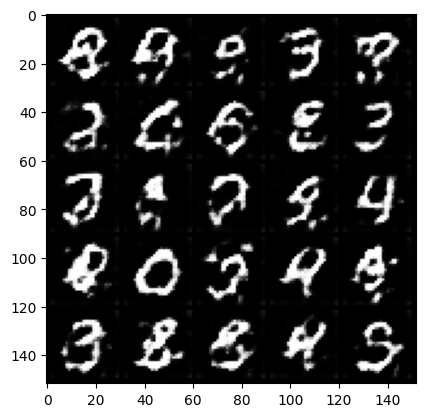

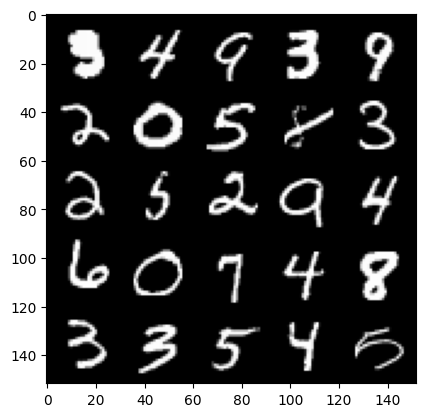

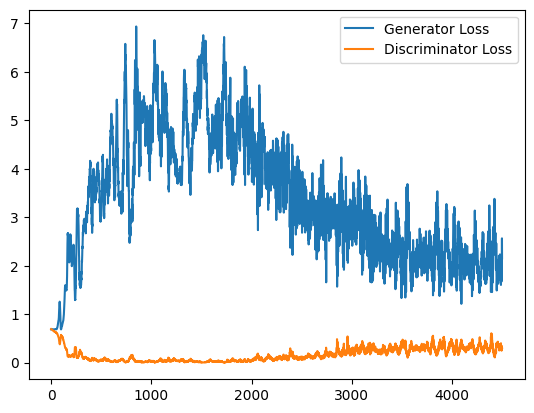

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5000: Generator loss: 2.1040163140296935, discriminator loss: 0.33780181461572645


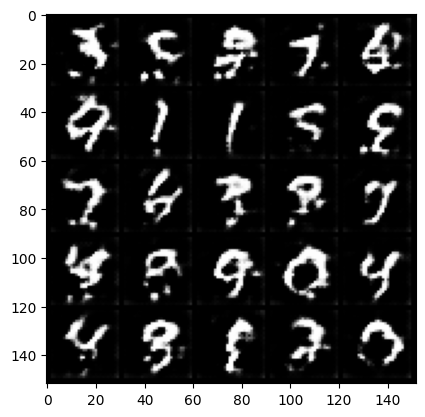

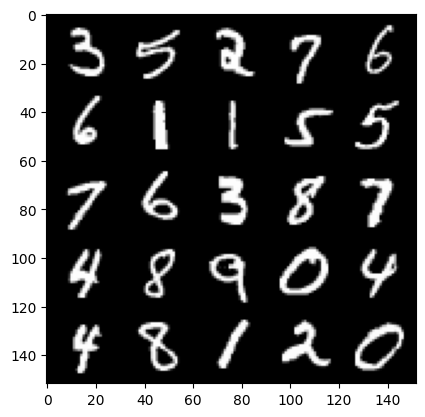

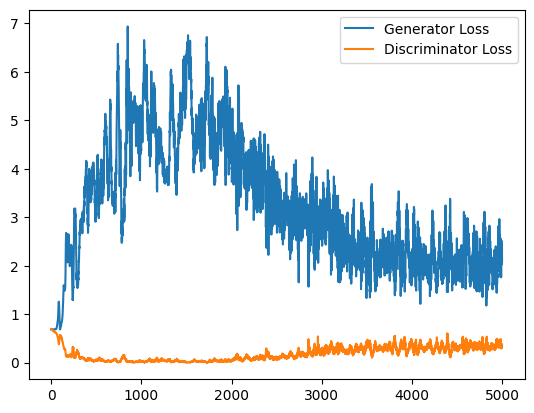

  0%|          | 0/469 [00:00<?, ?it/s]

Step 5500: Generator loss: 2.0610258758068083, discriminator loss: 0.34881473988294603


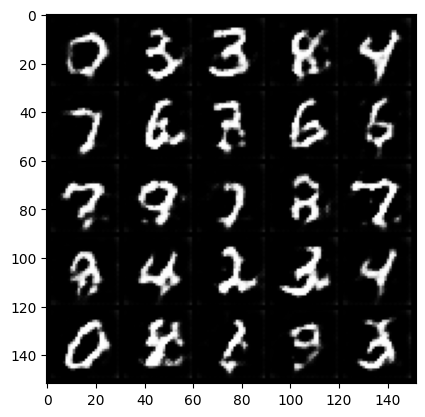

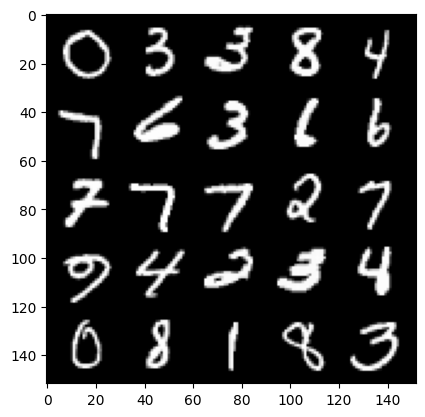

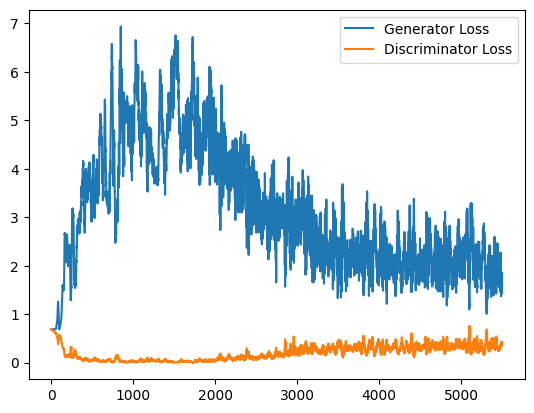

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6000: Generator loss: 1.7778189435005187, discriminator loss: 0.36953336068987847


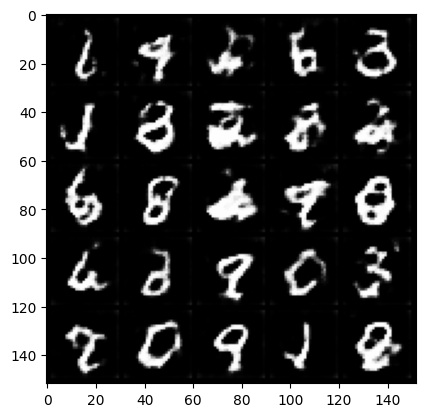

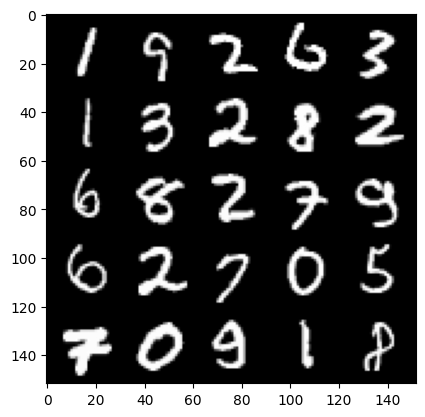

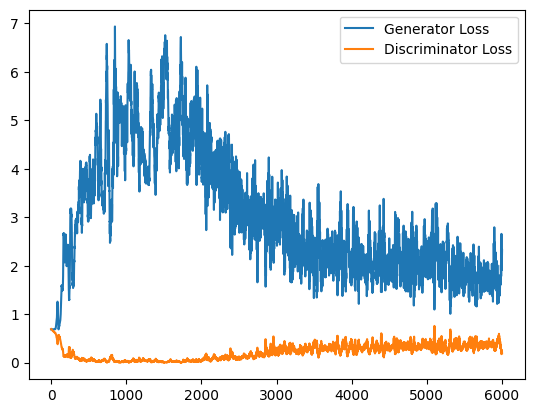

  0%|          | 0/469 [00:00<?, ?it/s]

Step 6500: Generator loss: 1.8164855551719665, discriminator loss: 0.3867748868763447


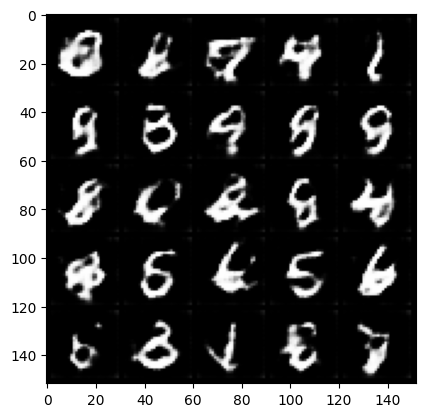

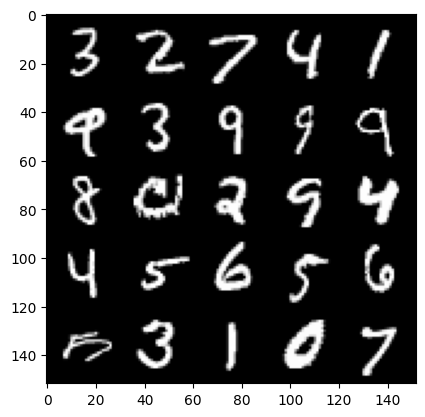

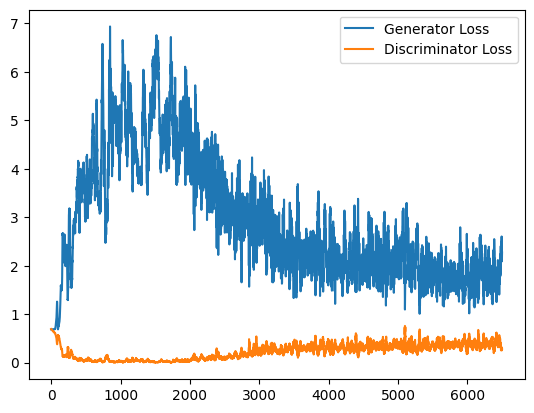

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7000: Generator loss: 1.7486898760795593, discriminator loss: 0.4211959674954414


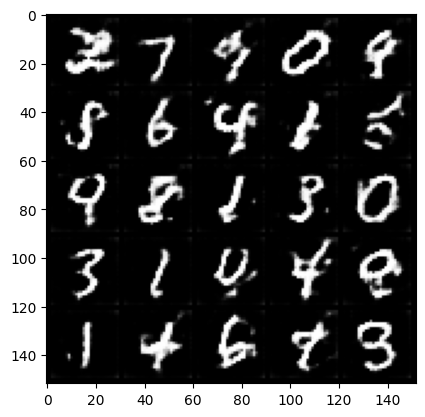

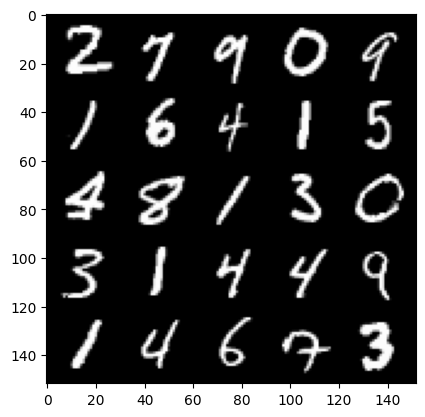

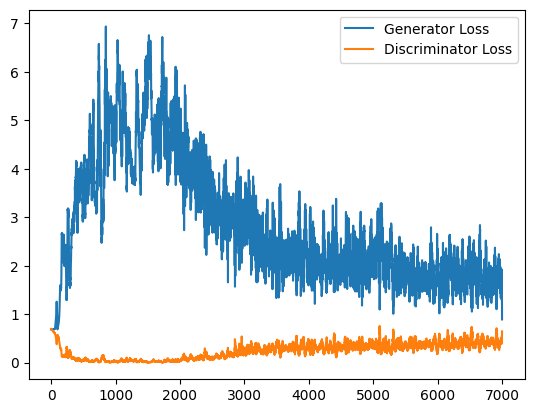

  0%|          | 0/469 [00:00<?, ?it/s]

Step 7500: Generator loss: 1.6302864904403687, discriminator loss: 0.4252768480479717


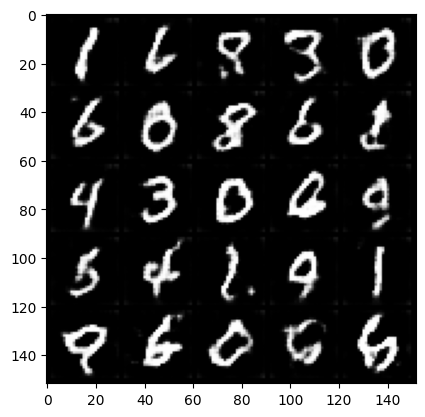

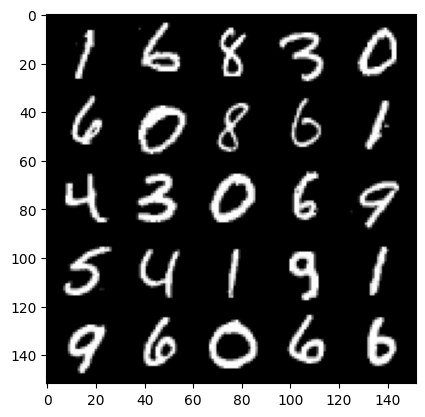

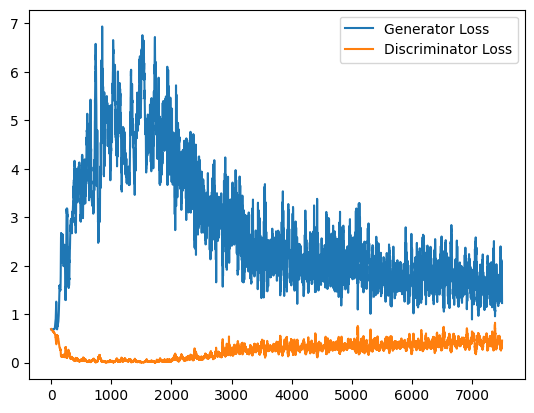

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8000: Generator loss: 1.5112486808300019, discriminator loss: 0.4498311933875084


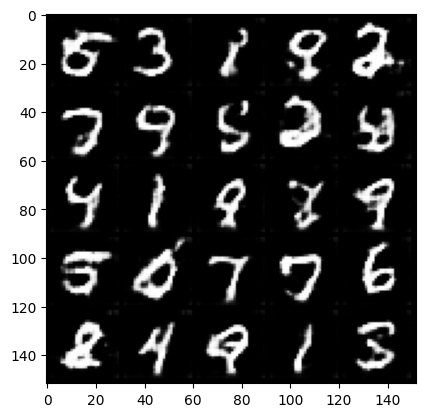

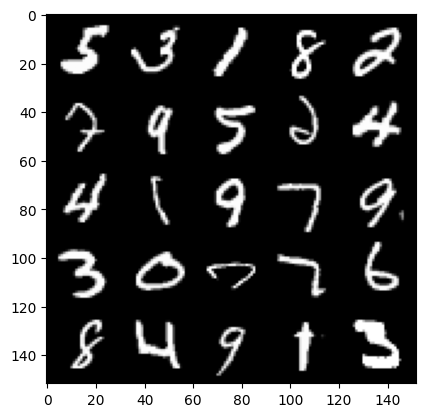

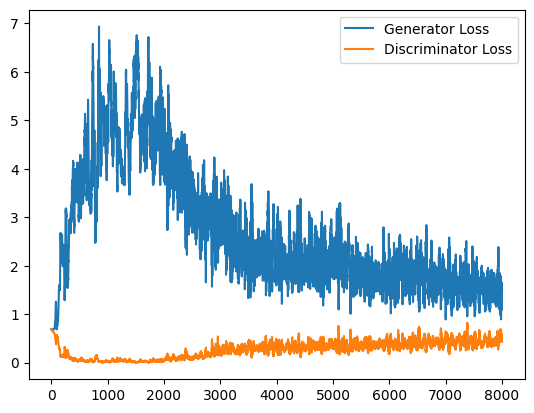

  0%|          | 0/469 [00:00<?, ?it/s]

Step 8500: Generator loss: 1.5868670270442962, discriminator loss: 0.45761346161365507


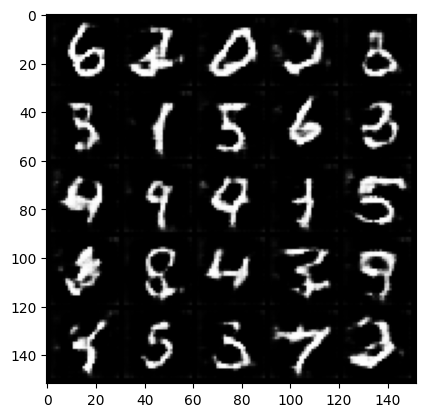

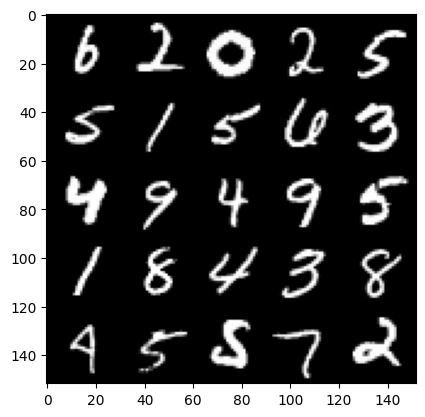

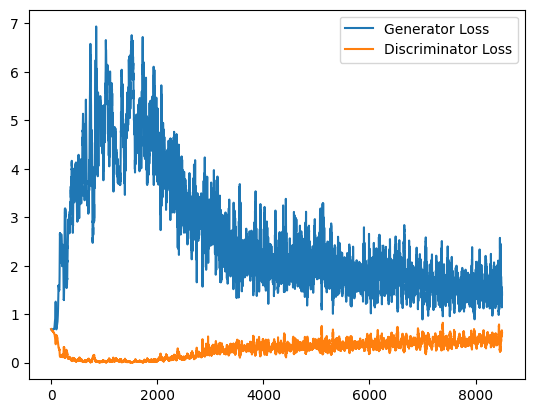

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9000: Generator loss: 1.494115713596344, discriminator loss: 0.4715124249458313


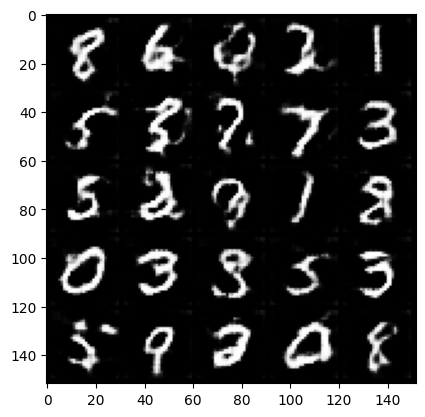

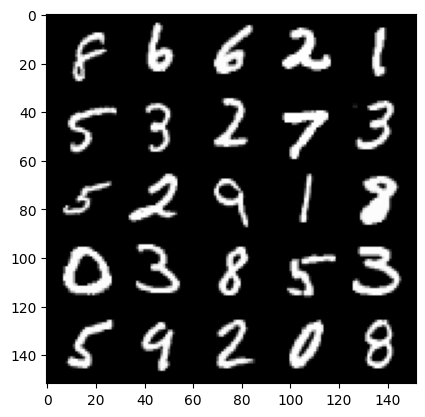

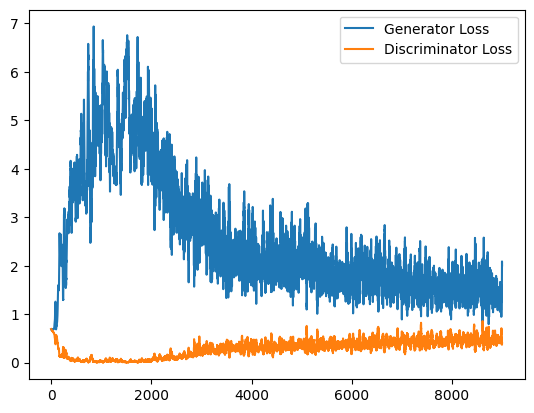

  0%|          | 0/469 [00:00<?, ?it/s]

Step 9500: Generator loss: 1.3945899575948715, discriminator loss: 0.4746253957748413


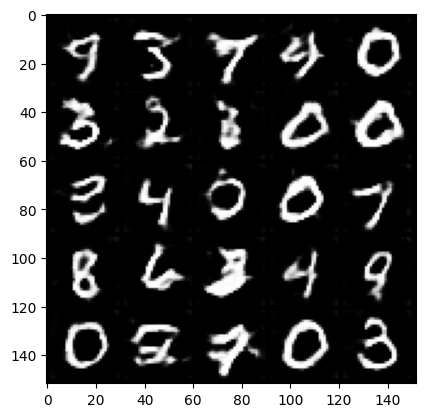

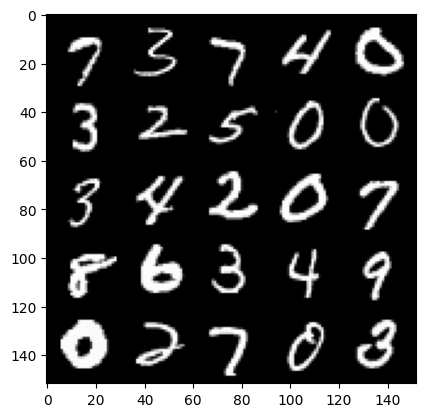

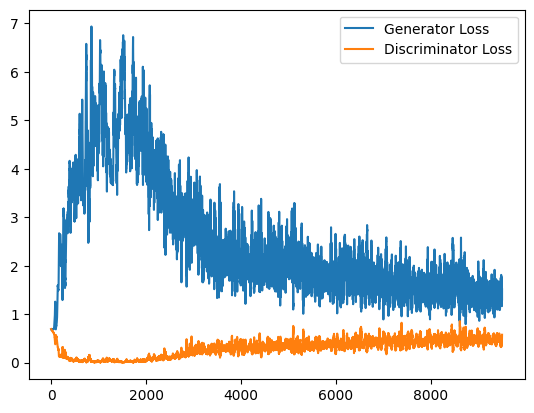

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10000: Generator loss: 1.3548125064373016, discriminator loss: 0.49588925164937975


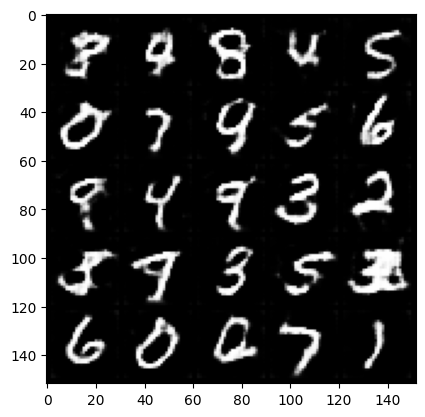

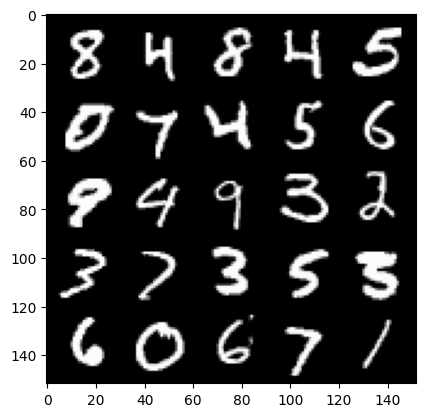

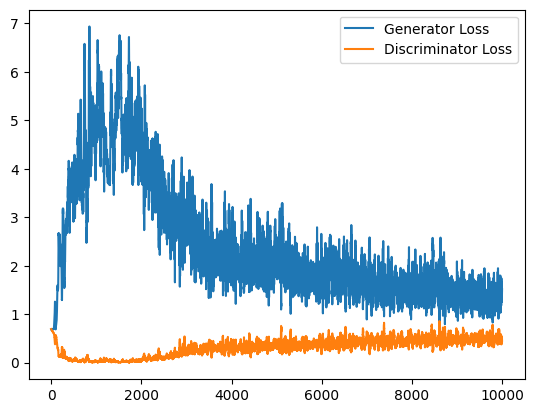

  0%|          | 0/469 [00:00<?, ?it/s]

Step 10500: Generator loss: 1.3428752533197403, discriminator loss: 0.5134855058193207


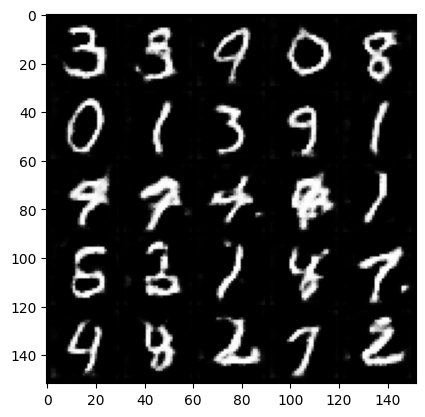

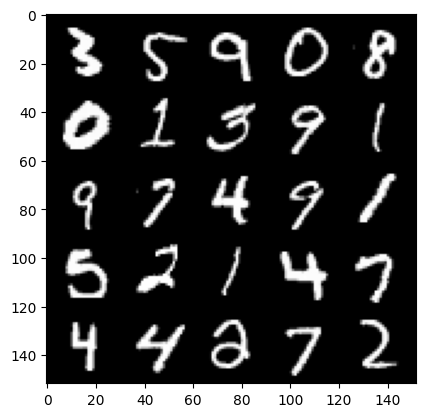

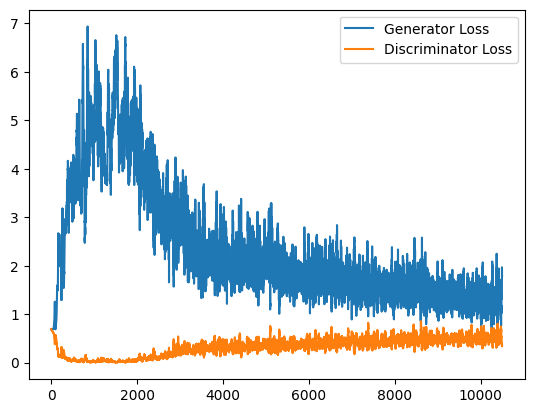

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11000: Generator loss: 1.3718668055534362, discriminator loss: 0.5057801706790924


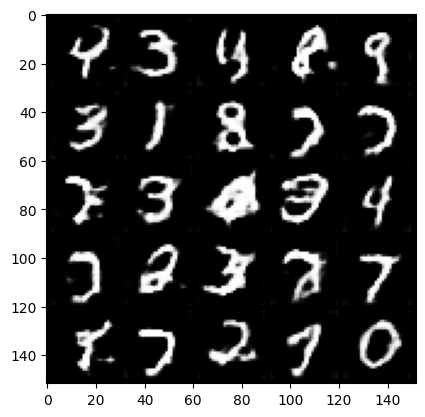

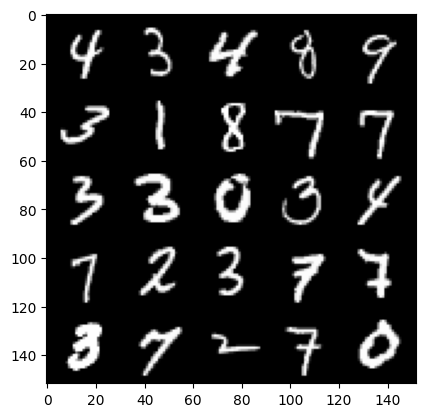

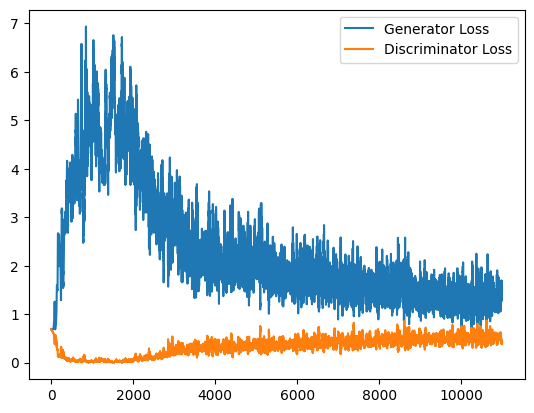

  0%|          | 0/469 [00:00<?, ?it/s]

Step 11500: Generator loss: 1.3362144170999526, discriminator loss: 0.5119984776377678


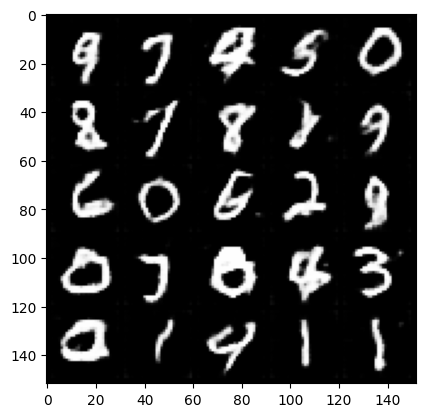

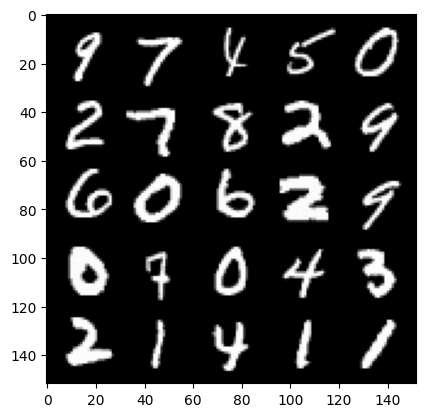

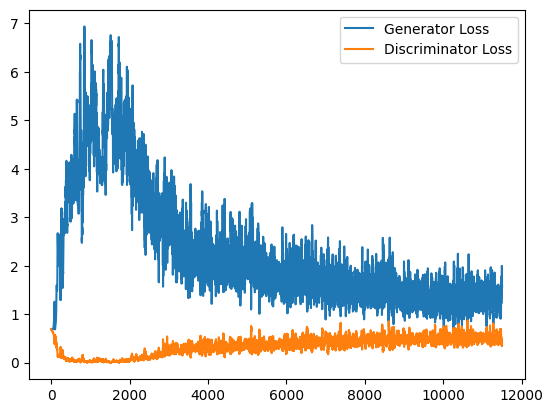

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12000: Generator loss: 1.3036356996297835, discriminator loss: 0.522938344836235


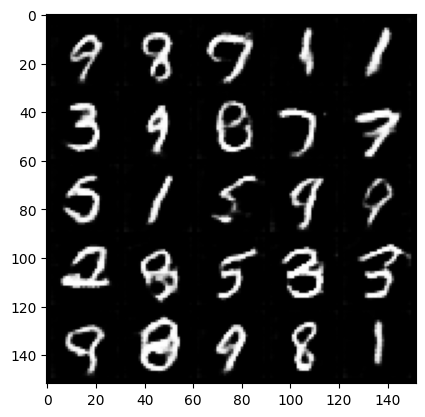

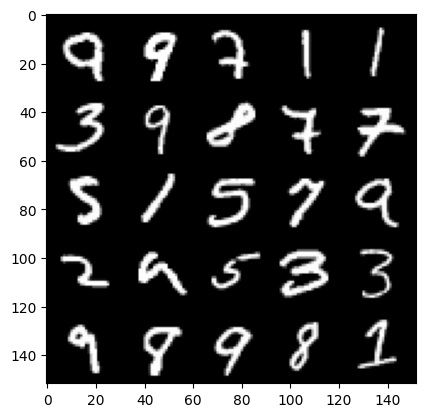

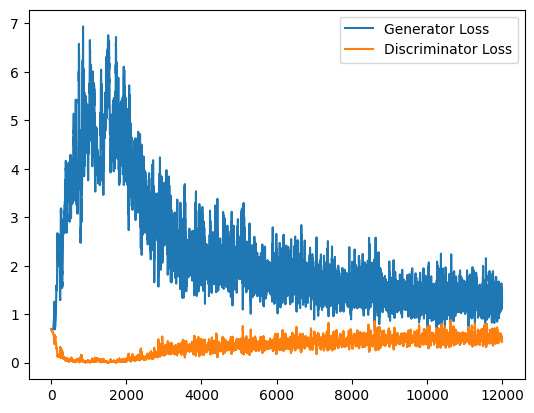

  0%|          | 0/469 [00:00<?, ?it/s]

Step 12500: Generator loss: 1.239785933971405, discriminator loss: 0.5311484538316726


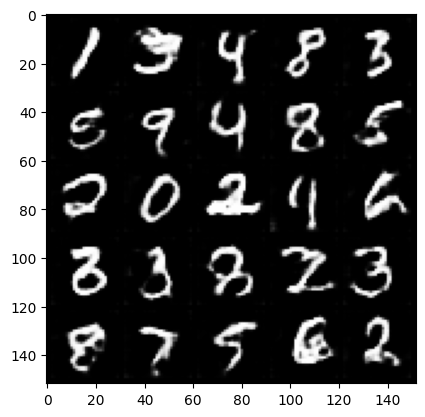

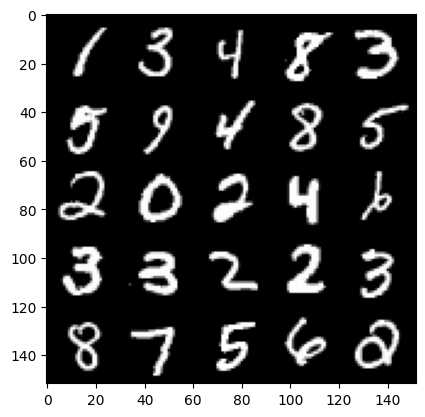

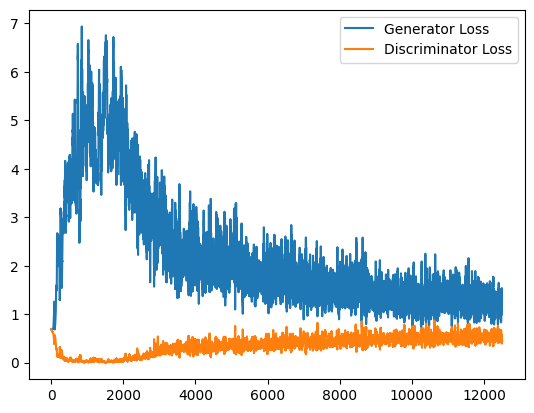

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13000: Generator loss: 1.238487392425537, discriminator loss: 0.5327925601601601


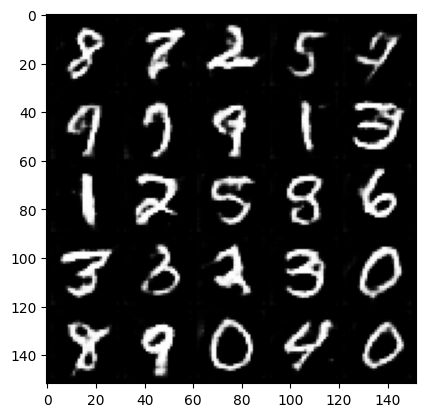

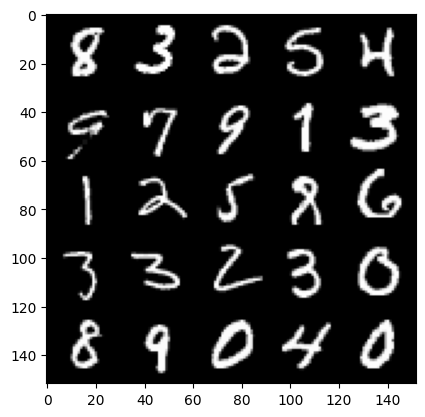

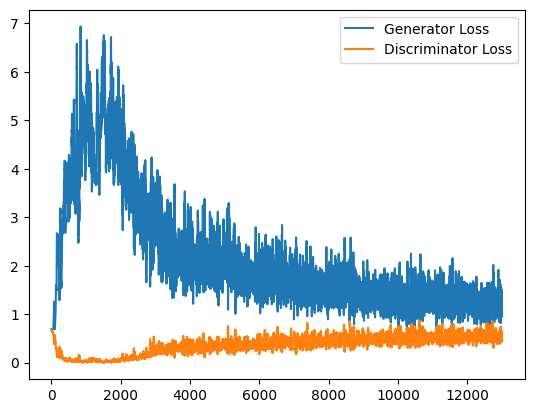

  0%|          | 0/469 [00:00<?, ?it/s]

Step 13500: Generator loss: 1.1934991726875306, discriminator loss: 0.5342097623944283


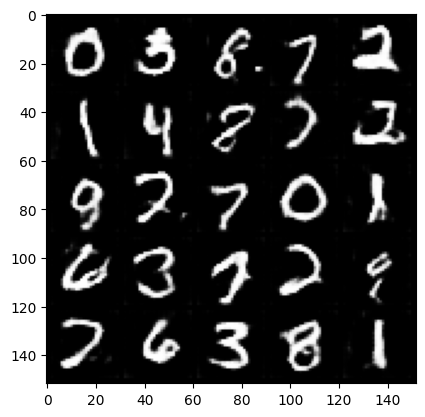

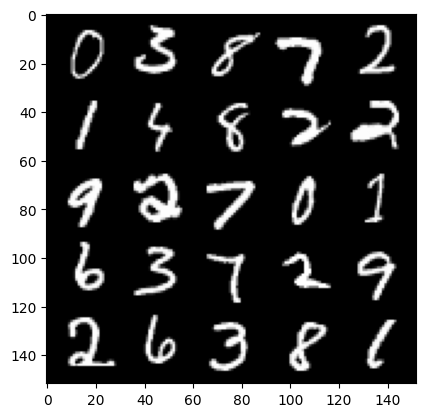

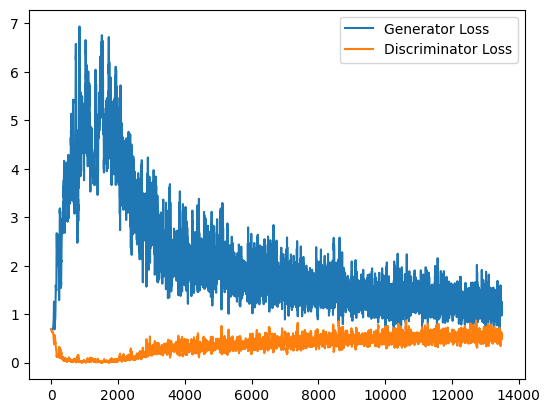

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14000: Generator loss: 1.2024035633802415, discriminator loss: 0.5335176000595093


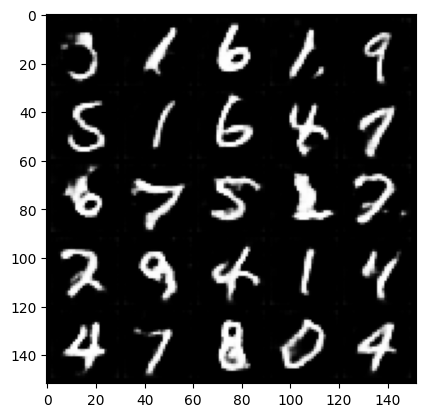

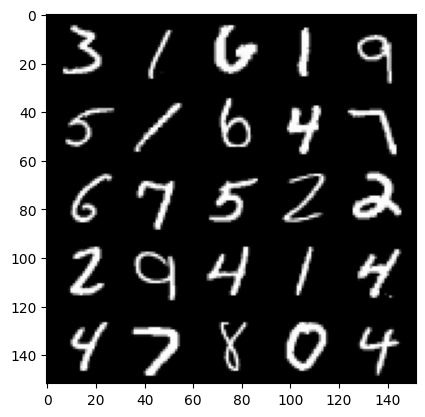

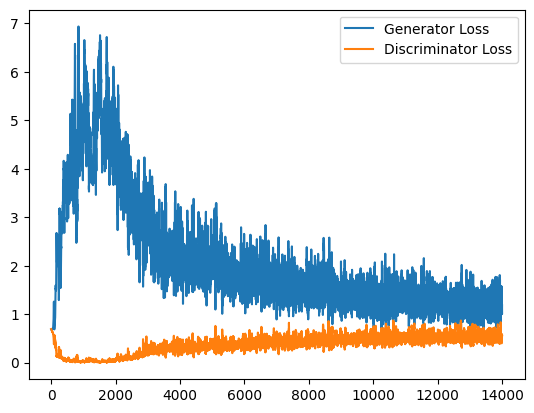

  0%|          | 0/469 [00:00<?, ?it/s]

Step 14500: Generator loss: 1.2394585379362106, discriminator loss: 0.5464309941530228


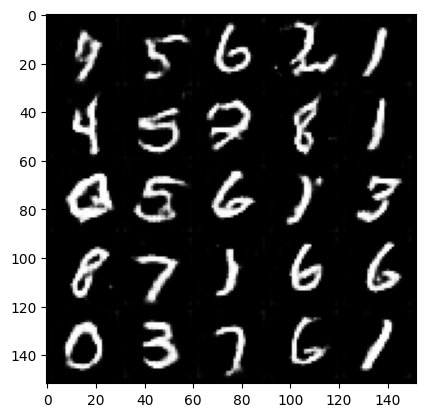

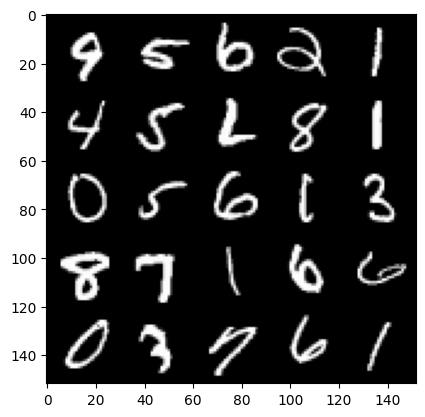

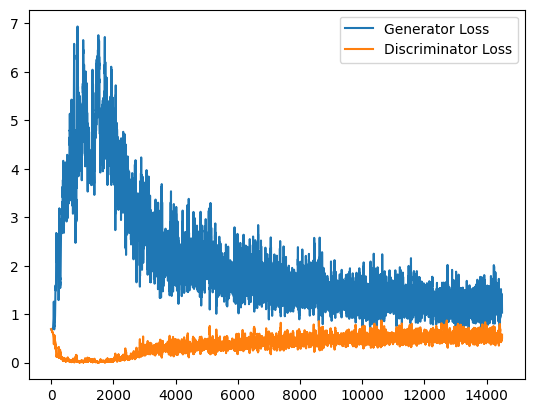

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15000: Generator loss: 1.1906837280988694, discriminator loss: 0.551818433523178


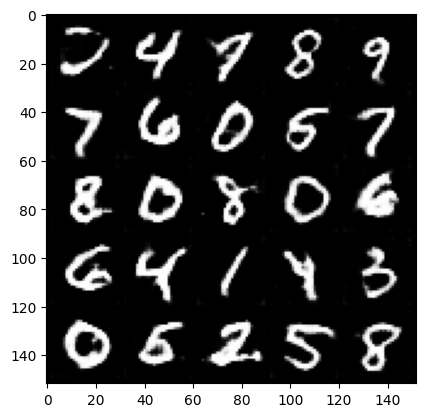

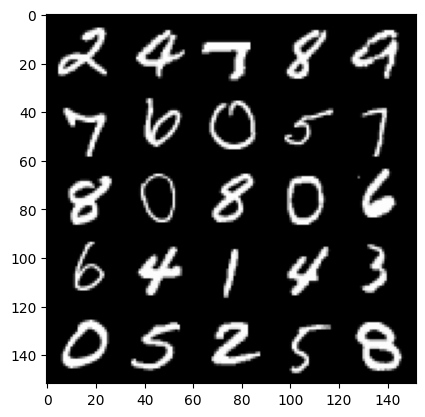

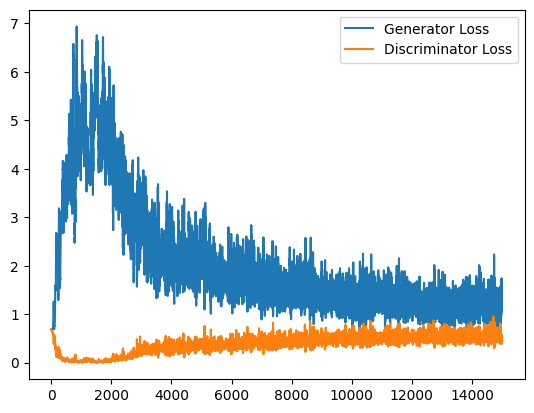

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 15500: Generator loss: 1.1306784294843675, discriminator loss: 0.5555894026756286


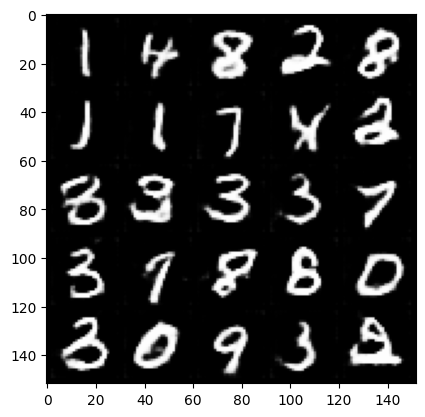

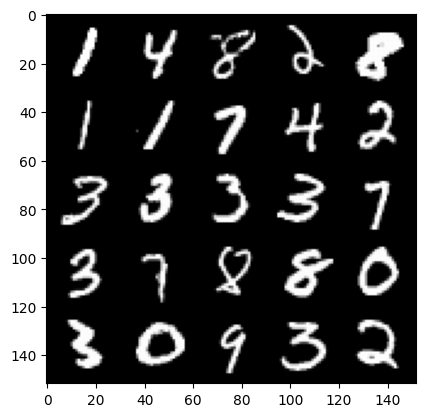

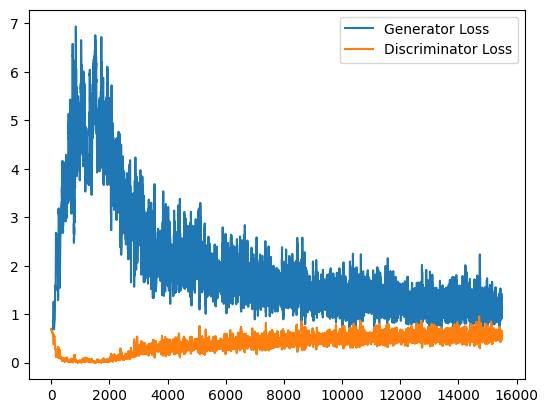

  0%|          | 0/469 [00:00<?, ?it/s]

Step 16000: Generator loss: 1.1605137535333634, discriminator loss: 0.5578796420693397


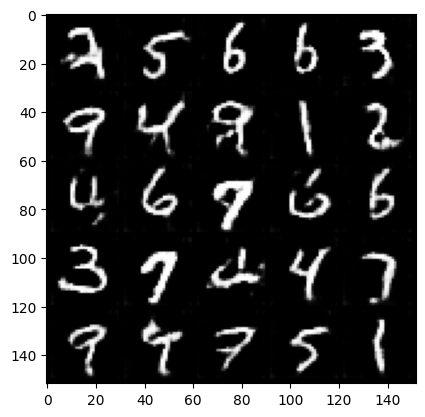

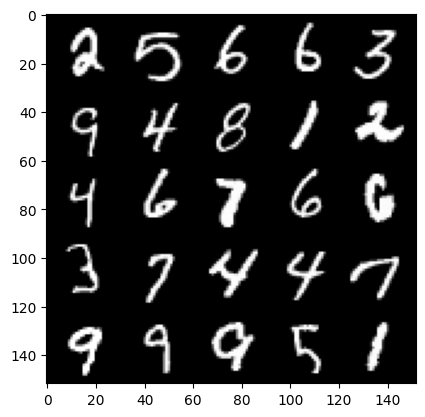

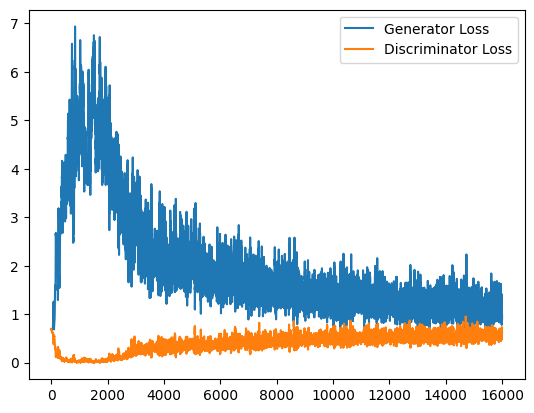

  0%|          | 0/469 [00:00<?, ?it/s]

Step 16500: Generator loss: 1.196528303027153, discriminator loss: 0.5540490739941597


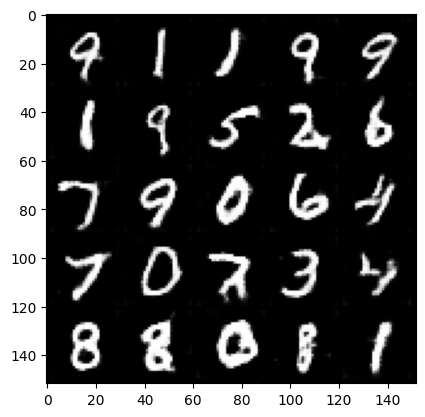

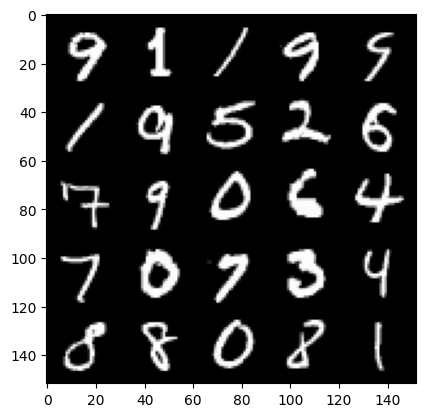

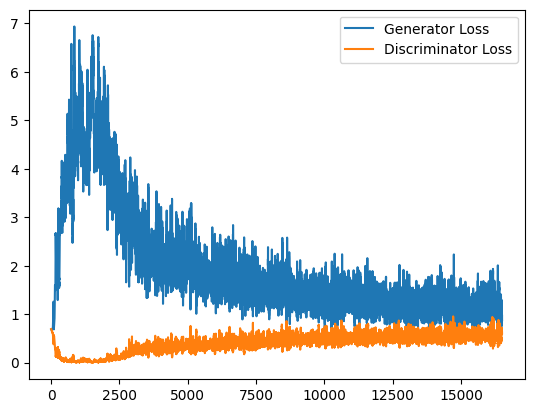

  0%|          | 0/469 [00:00<?, ?it/s]

Step 17000: Generator loss: 1.1256310558319091, discriminator loss: 0.5556563769578934


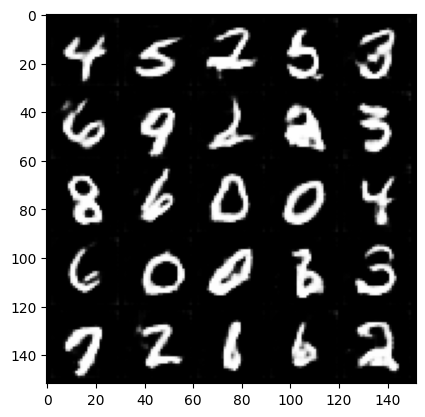

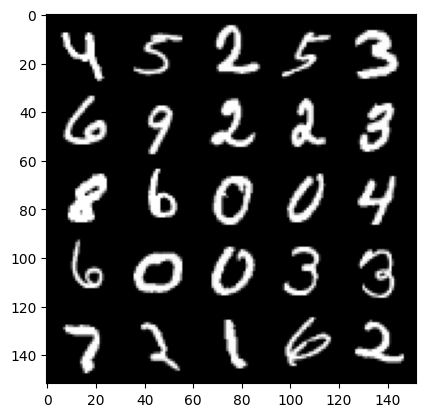

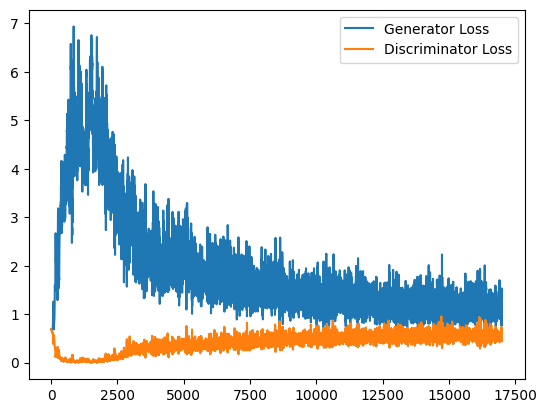

  0%|          | 0/469 [00:00<?, ?it/s]

Step 17500: Generator loss: 1.1470187293291092, discriminator loss: 0.5598732960820199


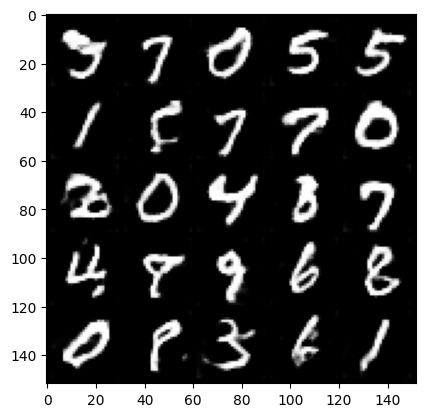

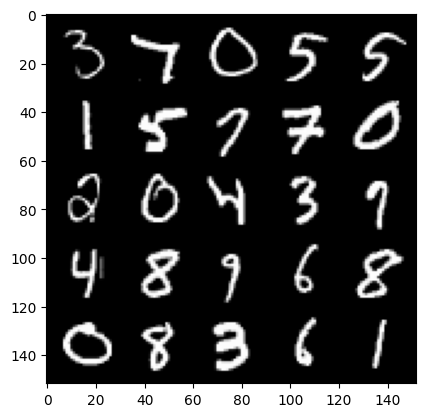

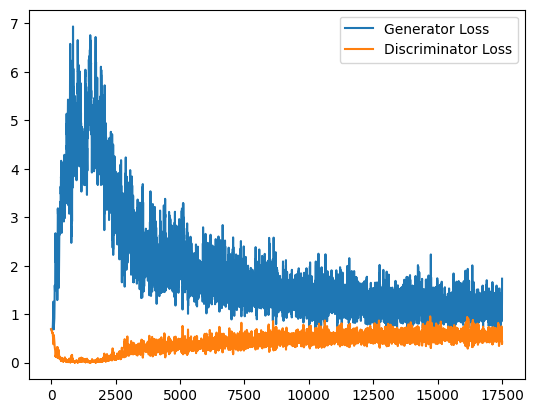

  0%|          | 0/469 [00:00<?, ?it/s]

Step 18000: Generator loss: 1.1231840261220931, discriminator loss: 0.5527031350135804


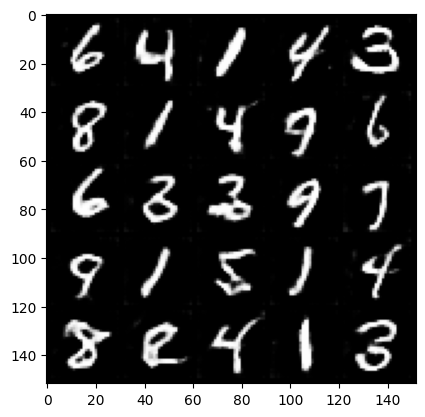

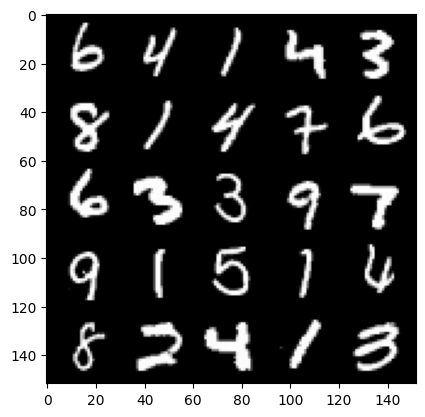

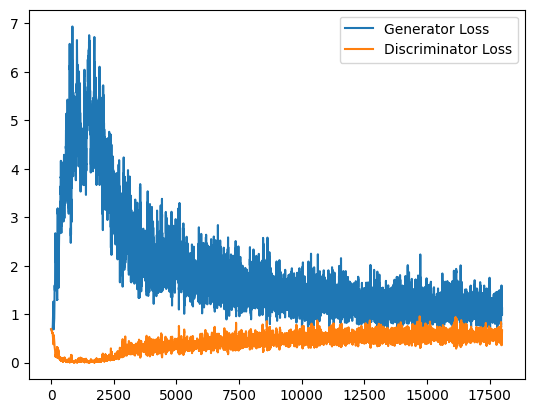

  0%|          | 0/469 [00:00<?, ?it/s]

Step 18500: Generator loss: 1.1318236385583877, discriminator loss: 0.5600744436979294


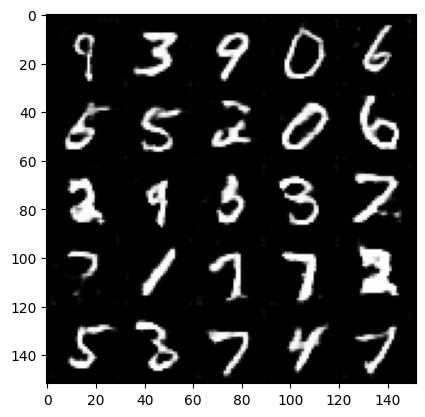

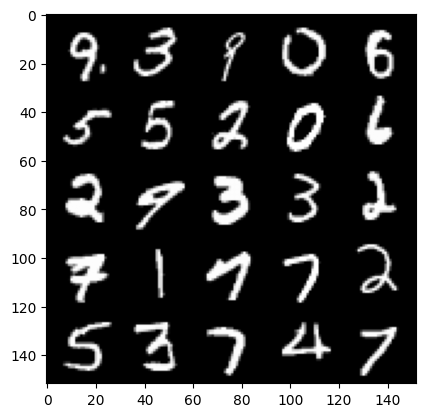

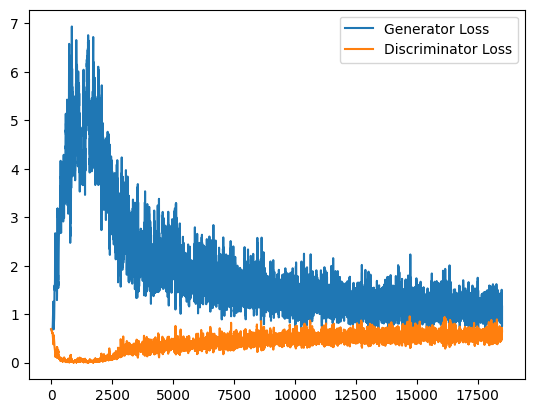

  0%|          | 0/469 [00:00<?, ?it/s]

Step 19000: Generator loss: 1.0699782863855363, discriminator loss: 0.5659338956475258


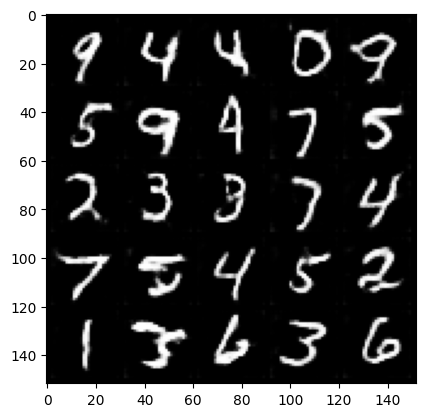

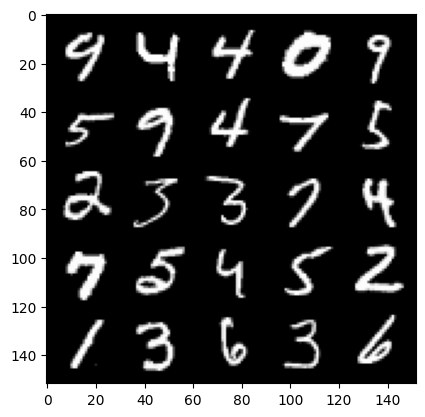

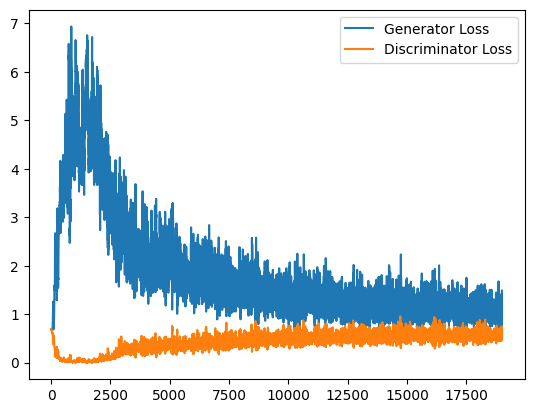

  0%|          | 0/469 [00:00<?, ?it/s]

Step 19500: Generator loss: 1.105109620332718, discriminator loss: 0.5608495690822601


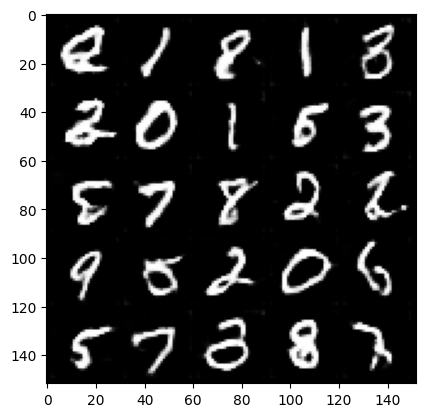

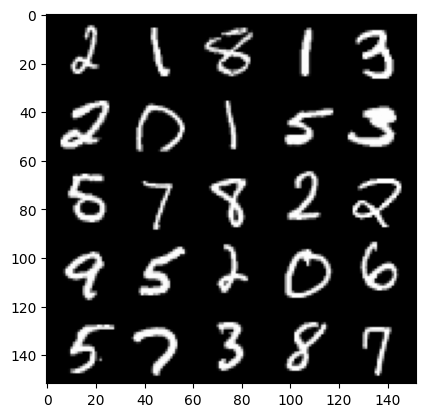

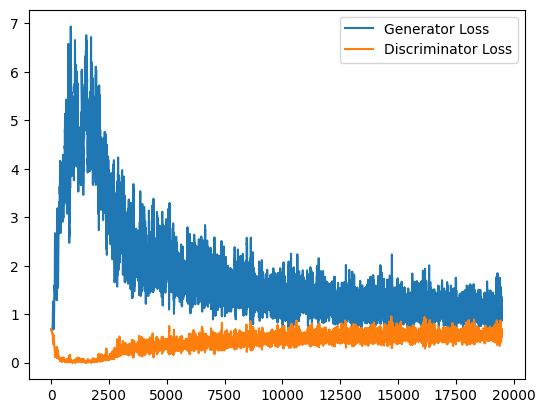

  0%|          | 0/469 [00:00<?, ?it/s]

Step 20000: Generator loss: 1.0713464430570603, discriminator loss: 0.5619532389640808


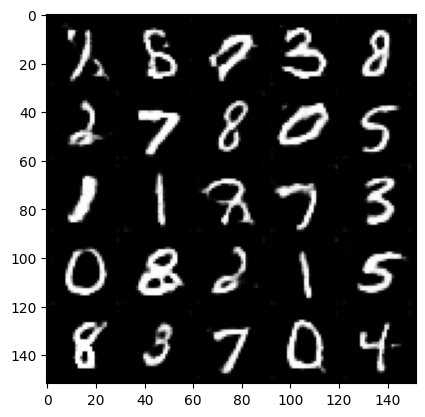

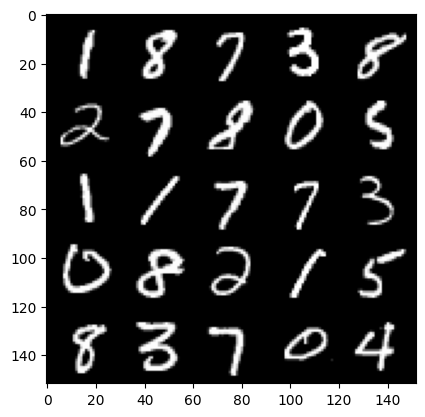

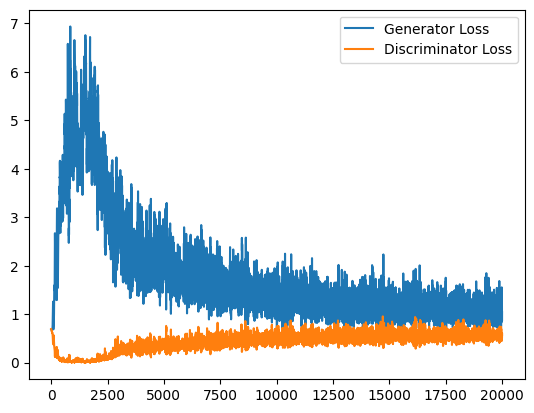

  0%|          | 0/469 [00:00<?, ?it/s]

Step 20500: Generator loss: 1.1034050801992417, discriminator loss: 0.5668101561665535


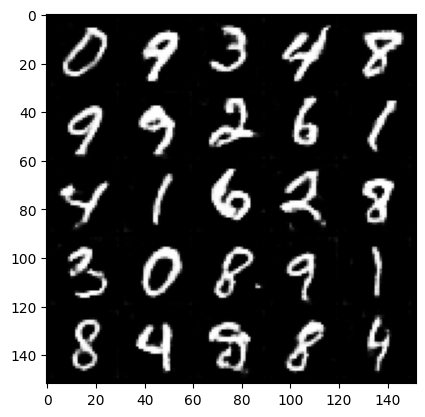

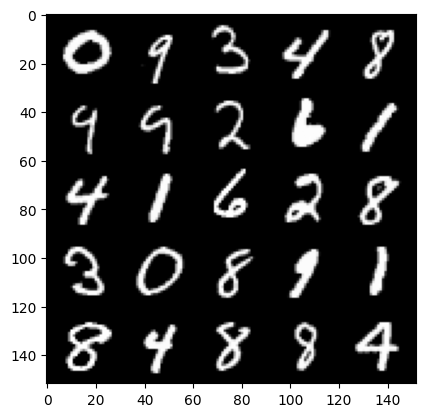

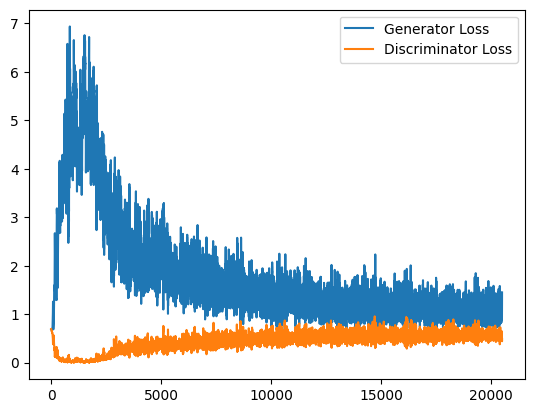

  0%|          | 0/469 [00:00<?, ?it/s]

Step 21000: Generator loss: 1.0962466510534286, discriminator loss: 0.5688765913844108


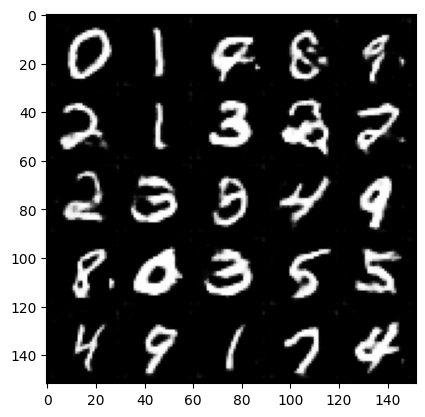

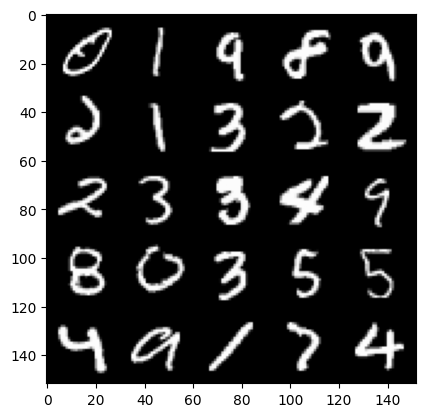

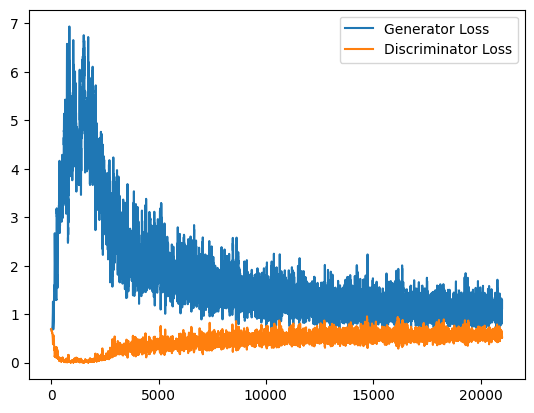

  0%|          | 0/469 [00:00<?, ?it/s]

Step 21500: Generator loss: 1.0579228681325912, discriminator loss: 0.5664629544019699


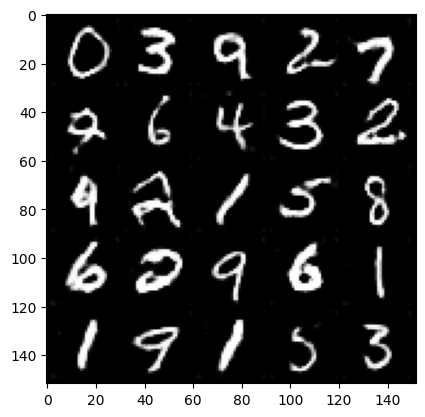

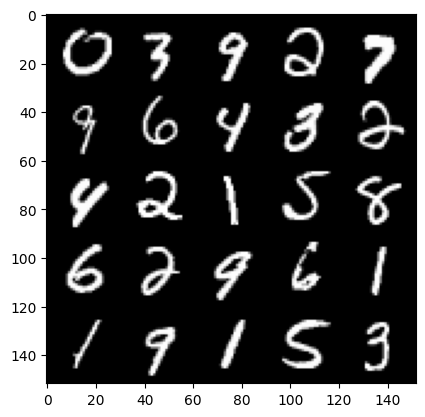

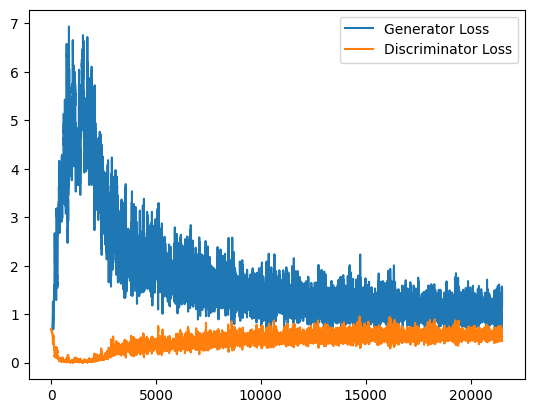

  0%|          | 0/469 [00:00<?, ?it/s]

Step 22000: Generator loss: 1.0729004093408585, discriminator loss: 0.5735788332223892


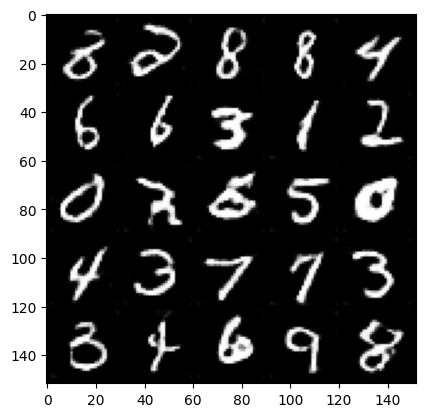

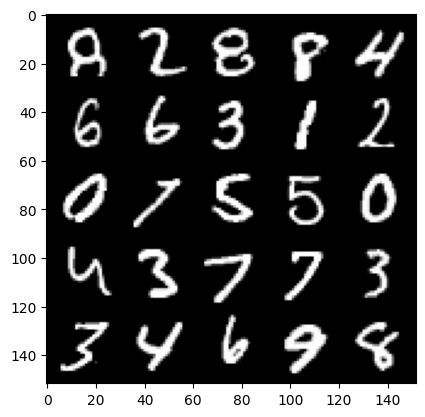

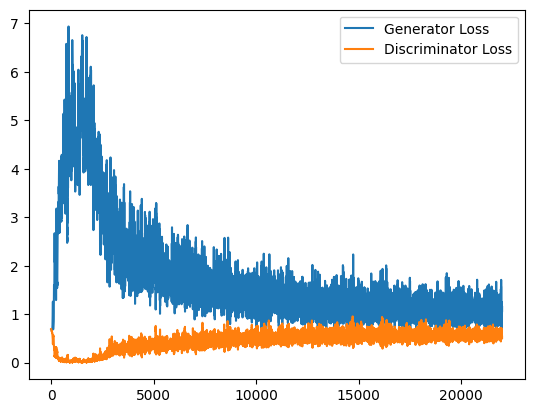

  0%|          | 0/469 [00:00<?, ?it/s]

Step 22500: Generator loss: 1.0614576114416123, discriminator loss: 0.5722332710623741


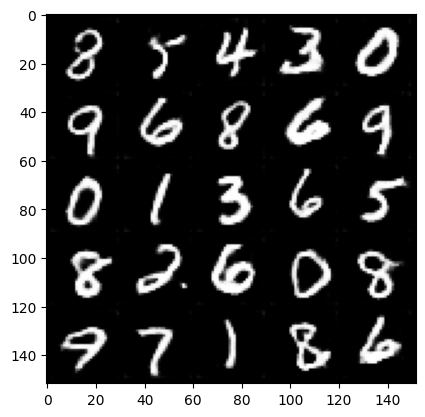

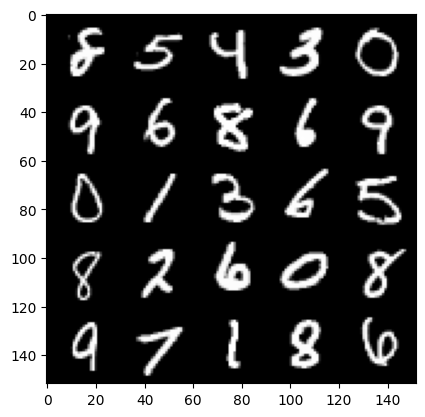

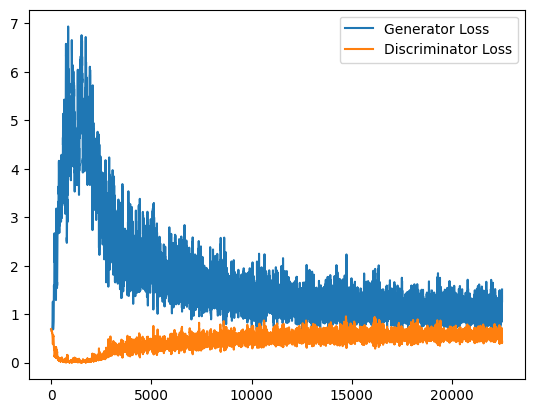

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 23000: Generator loss: 1.0675722364187241, discriminator loss: 0.5732628793716431


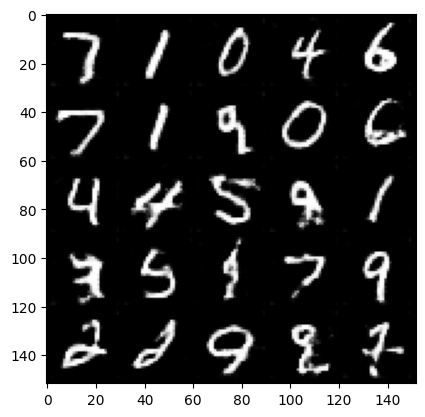

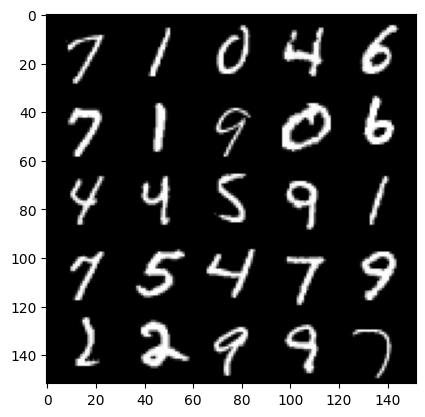

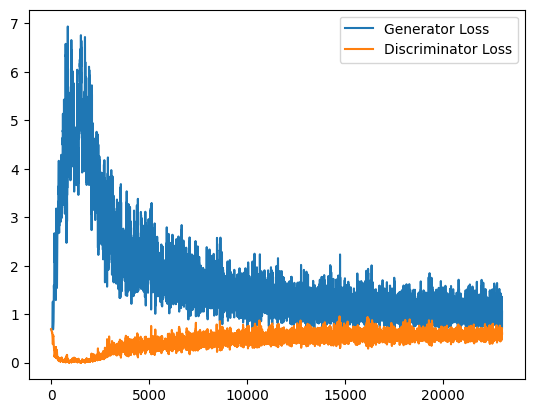

  0%|          | 0/469 [00:00<?, ?it/s]

Step 23500: Generator loss: 1.0379327857494354, discriminator loss: 0.5771850924491883


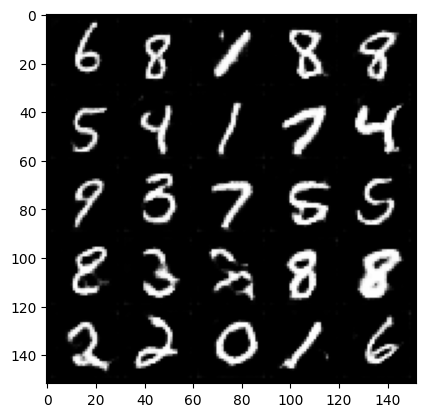

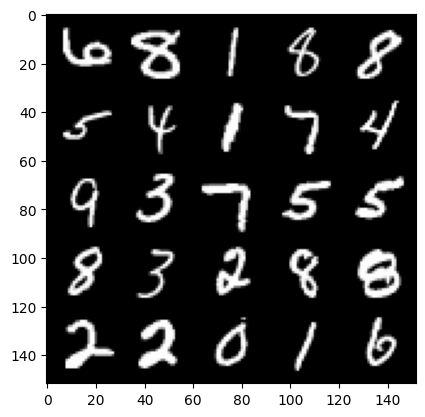

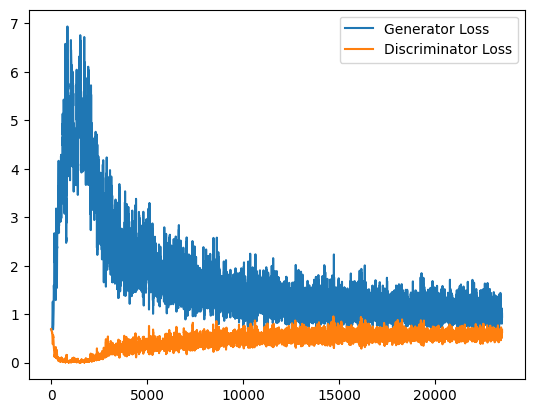

  0%|          | 0/469 [00:00<?, ?it/s]

Step 24000: Generator loss: 1.0557826578617096, discriminator loss: 0.5799440783262253


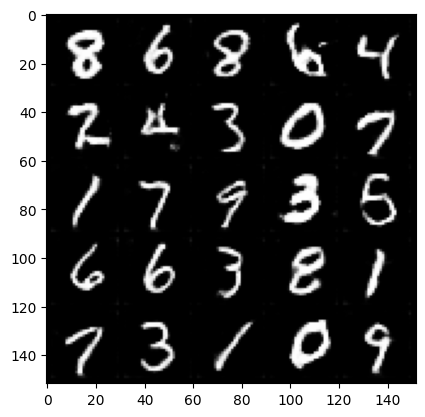

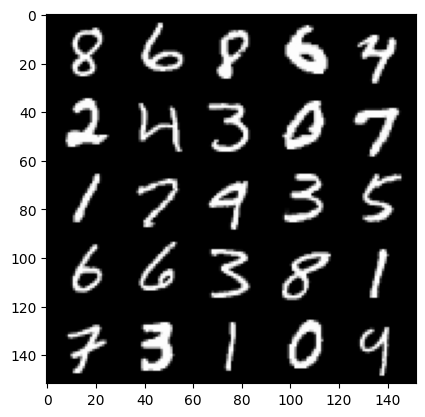

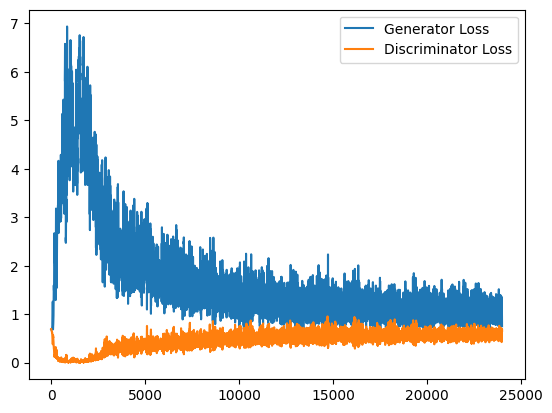

  0%|          | 0/469 [00:00<?, ?it/s]

Step 24500: Generator loss: 1.0739078570604323, discriminator loss: 0.5852340387105942


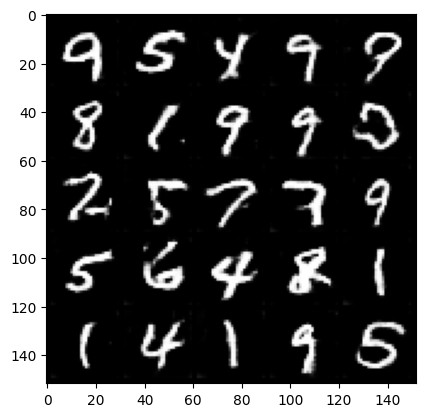

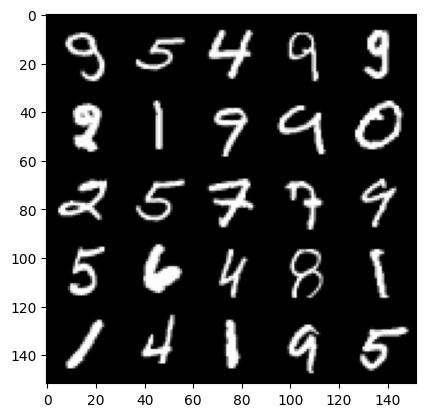

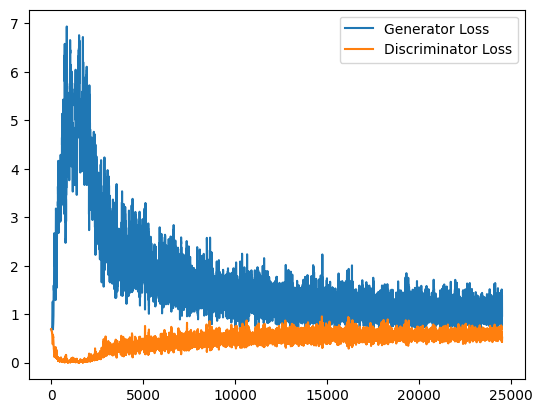

  0%|          | 0/469 [00:00<?, ?it/s]

Step 25000: Generator loss: 1.0560939269065857, discriminator loss: 0.5825908795595169


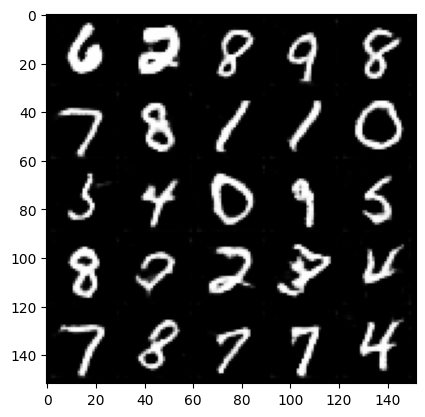

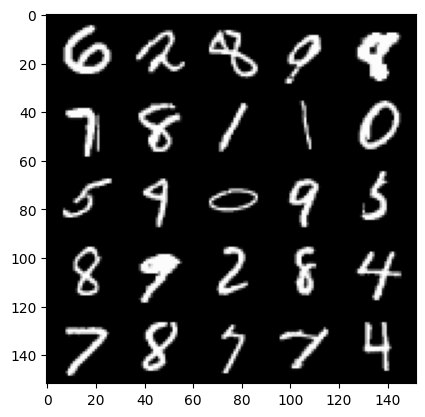

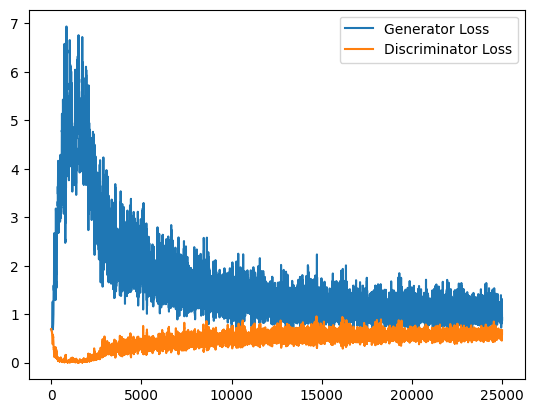

  0%|          | 0/469 [00:00<?, ?it/s]

Step 25500: Generator loss: 1.0135689356327058, discriminator loss: 0.5863029980063439


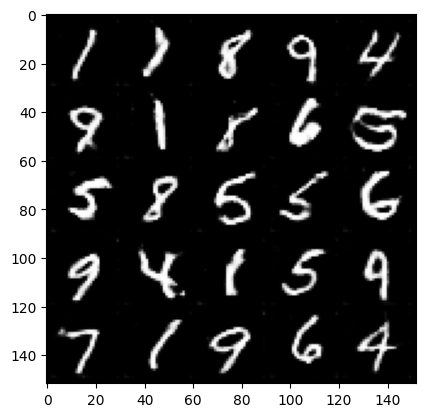

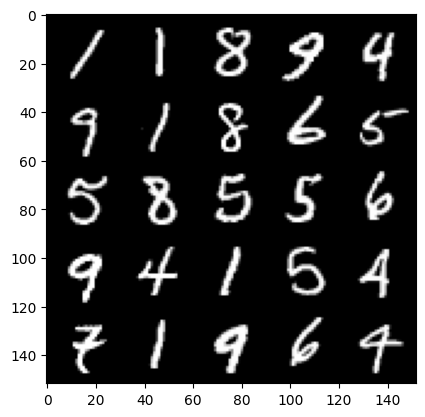

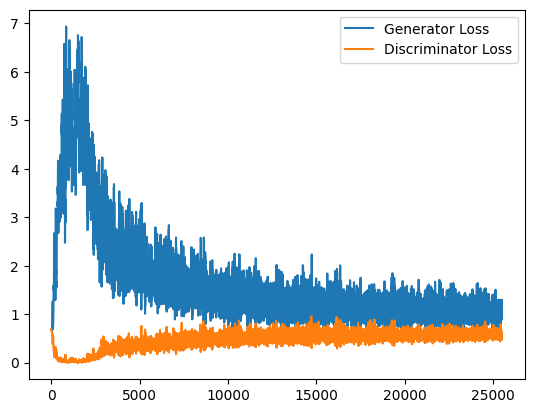

  0%|          | 0/469 [00:00<?, ?it/s]

Step 26000: Generator loss: 1.0259939662218094, discriminator loss: 0.5924483268857003


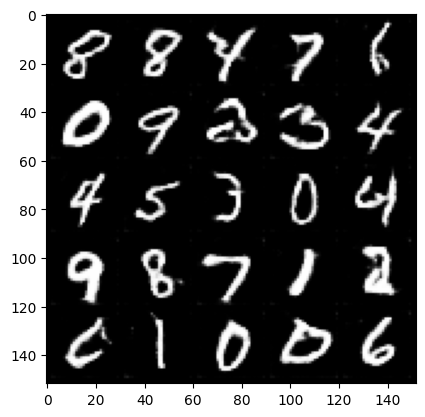

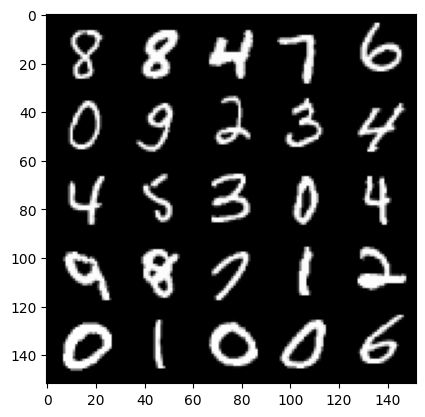

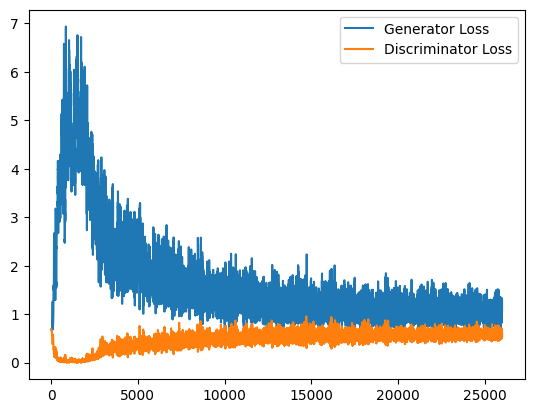

  0%|          | 0/469 [00:00<?, ?it/s]

Step 26500: Generator loss: 1.0435957325696945, discriminator loss: 0.59692458152771


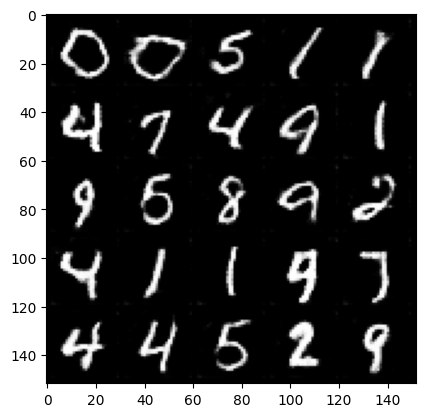

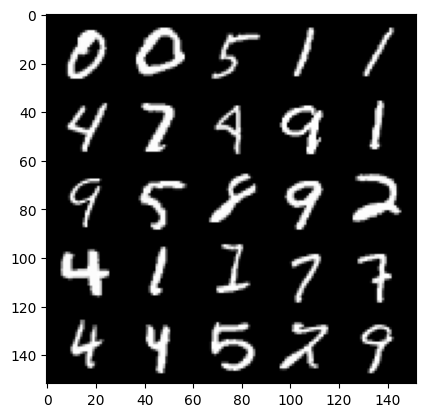

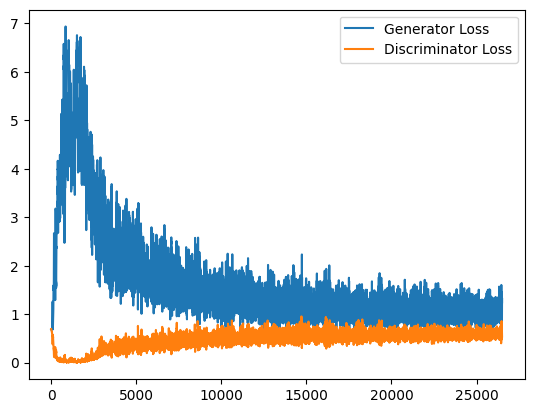

  0%|          | 0/469 [00:00<?, ?it/s]

Step 27000: Generator loss: 1.039322697997093, discriminator loss: 0.5972377763390541


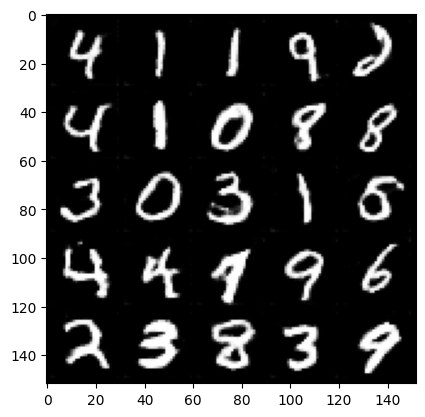

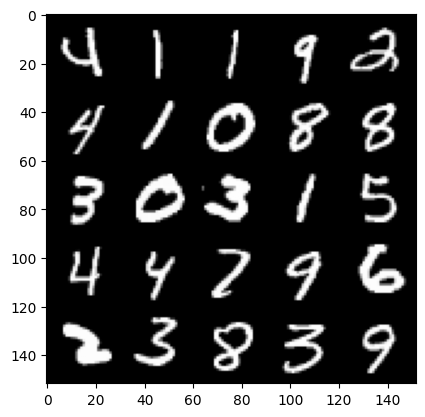

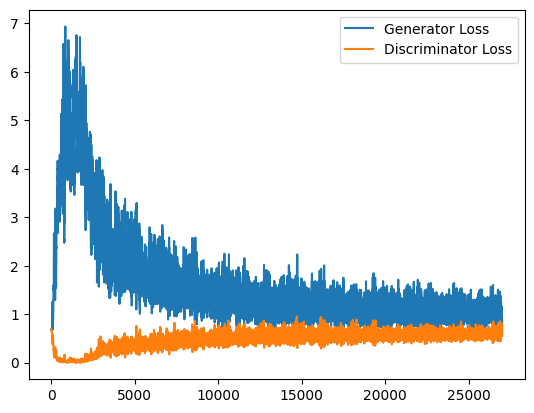

  0%|          | 0/469 [00:00<?, ?it/s]

Step 27500: Generator loss: 1.0156222972869873, discriminator loss: 0.5924148164987564


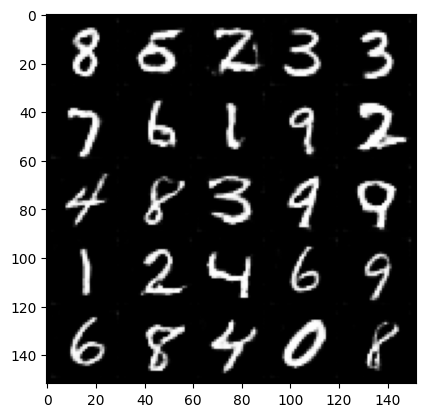

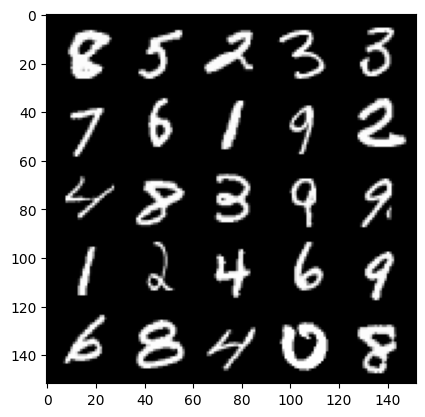

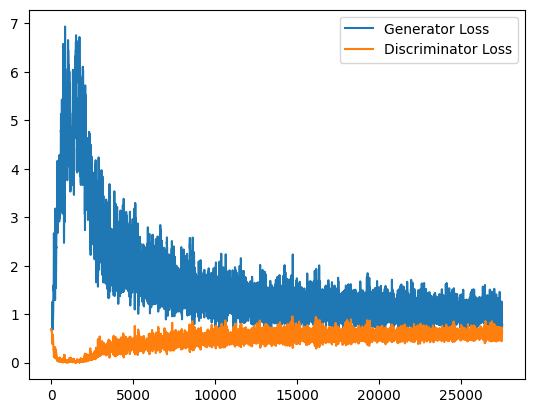

  0%|          | 0/469 [00:00<?, ?it/s]

Step 28000: Generator loss: 0.9825223327875138, discriminator loss: 0.5977464824914932


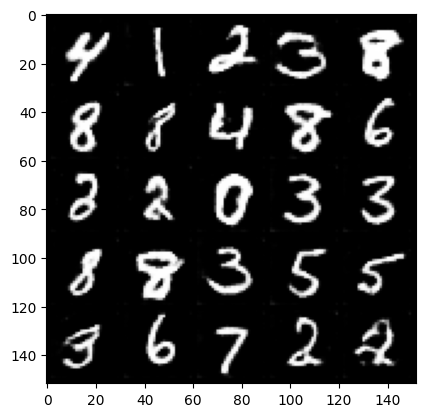

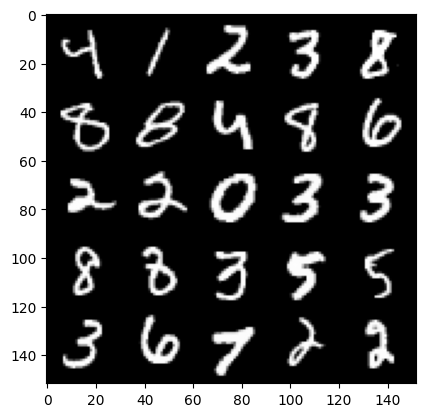

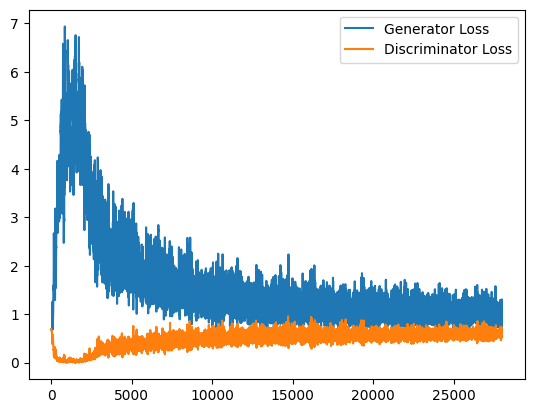

  0%|          | 0/469 [00:00<?, ?it/s]

Step 28500: Generator loss: 1.0267248475551605, discriminator loss: 0.5999754729866982


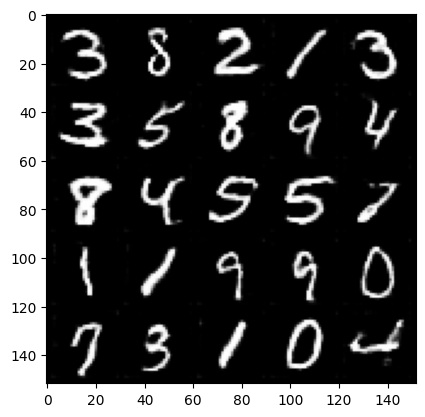

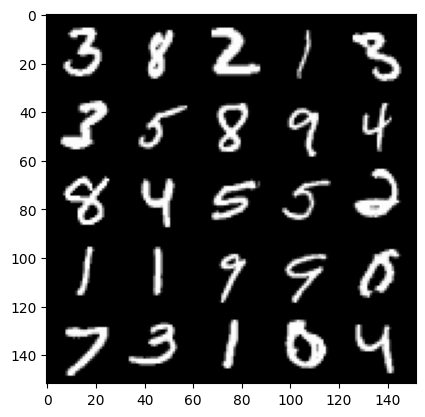

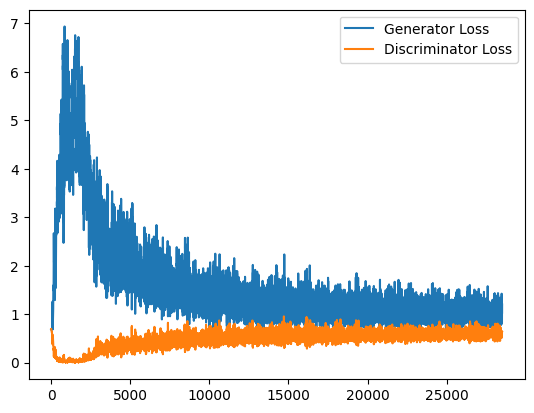

  0%|          | 0/469 [00:00<?, ?it/s]

Step 29000: Generator loss: 1.022657949090004, discriminator loss: 0.6048442770242691


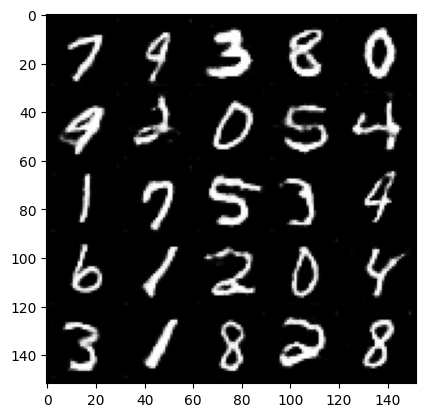

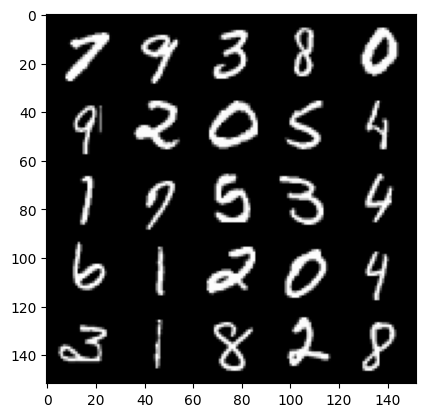

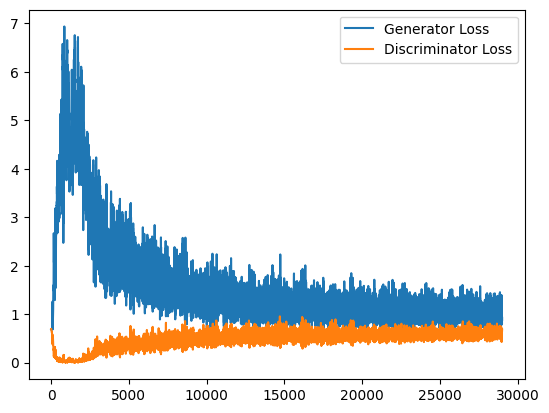

  0%|          | 0/469 [00:00<?, ?it/s]

Step 29500: Generator loss: 0.9945368995666504, discriminator loss: 0.5999819940328598


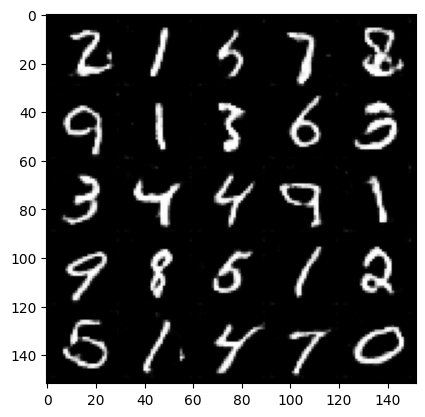

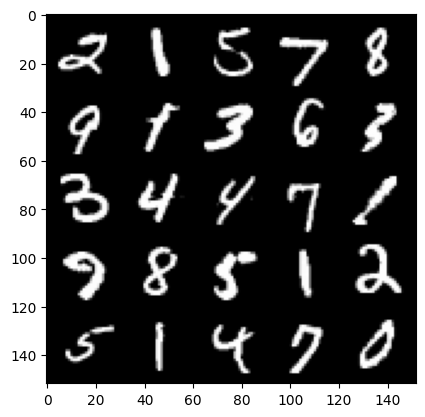

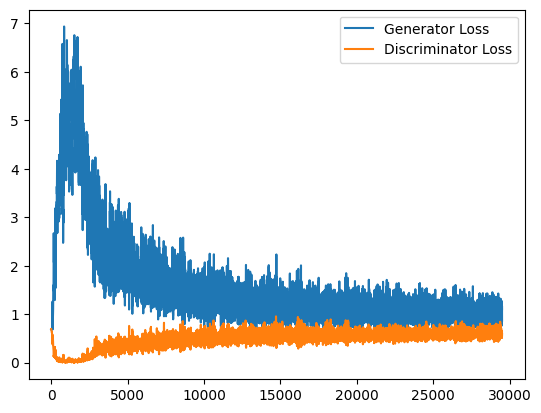

  0%|          | 0/469 [00:00<?, ?it/s]

Step 30000: Generator loss: 1.0350270446538925, discriminator loss: 0.5989443846344947


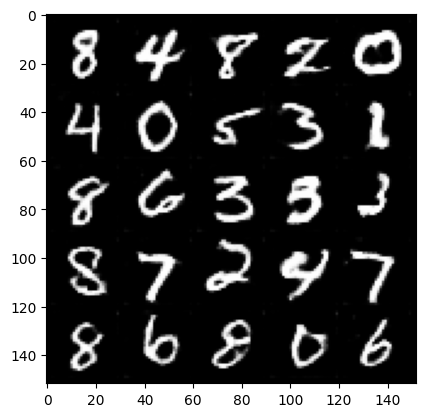

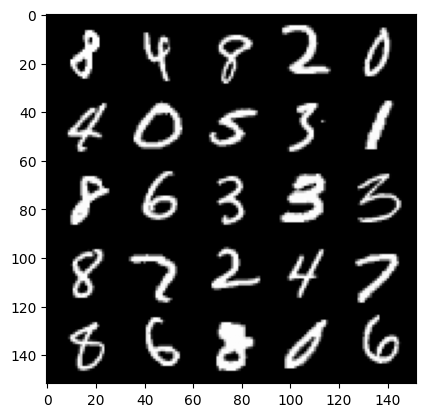

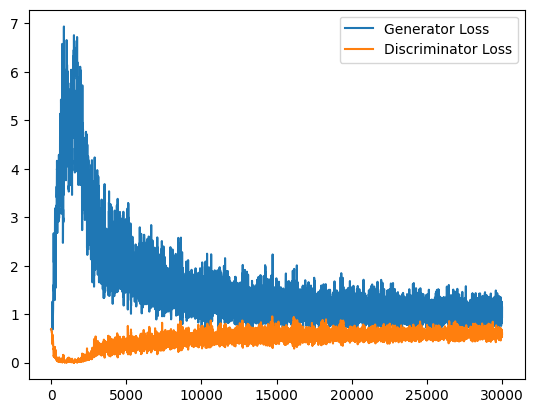

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 30500: Generator loss: 0.9939396464824677, discriminator loss: 0.6066454225778579


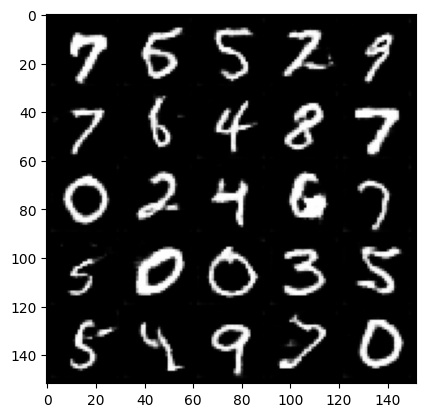

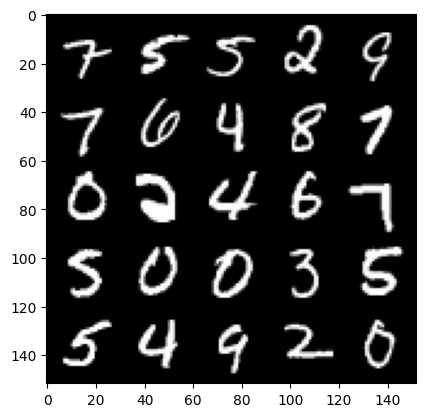

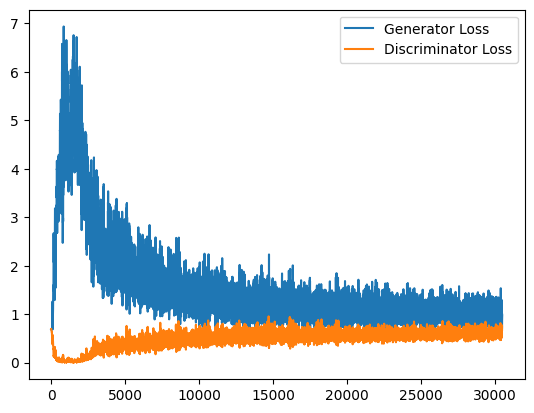

  0%|          | 0/469 [00:00<?, ?it/s]

Step 31000: Generator loss: 1.012315003991127, discriminator loss: 0.6048464921712875


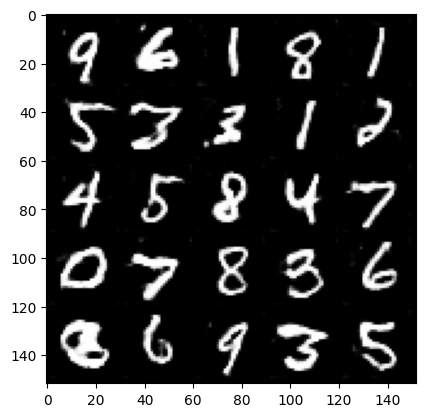

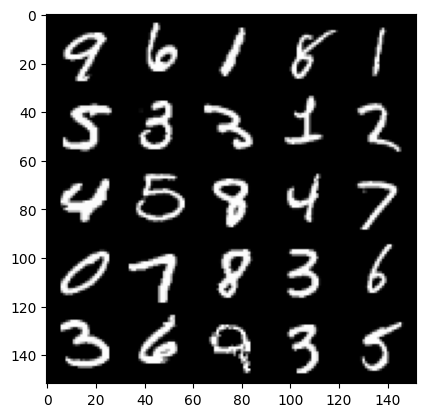

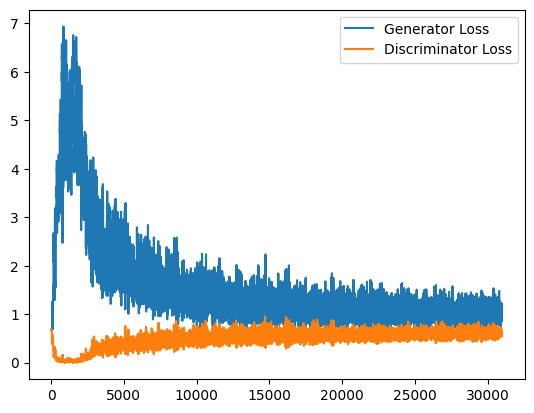

  0%|          | 0/469 [00:00<?, ?it/s]

Step 31500: Generator loss: 1.02014013838768, discriminator loss: 0.5997409811019897


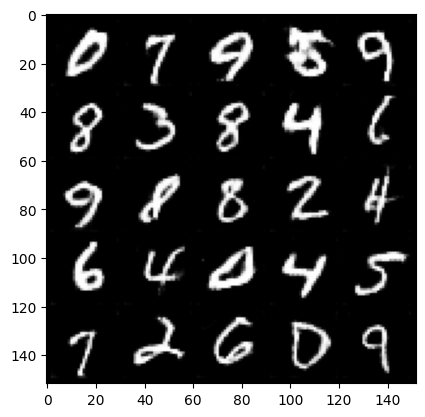

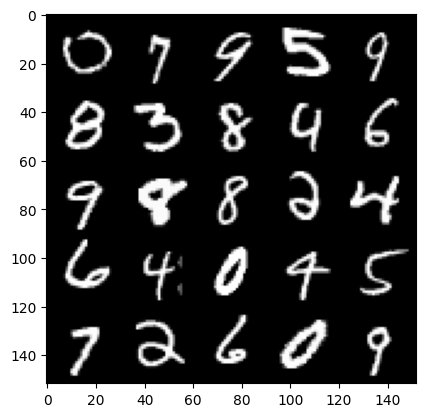

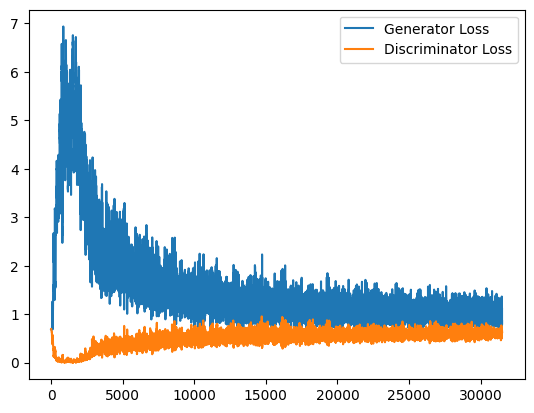

  0%|          | 0/469 [00:00<?, ?it/s]

Step 32000: Generator loss: 1.0121402271986009, discriminator loss: 0.60259622579813


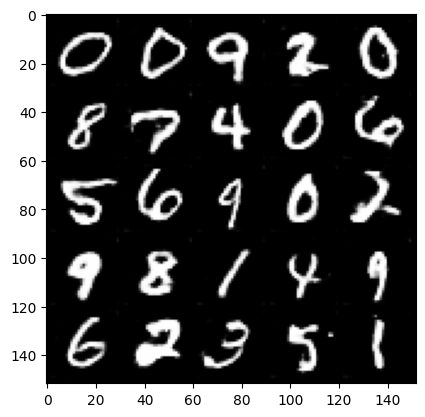

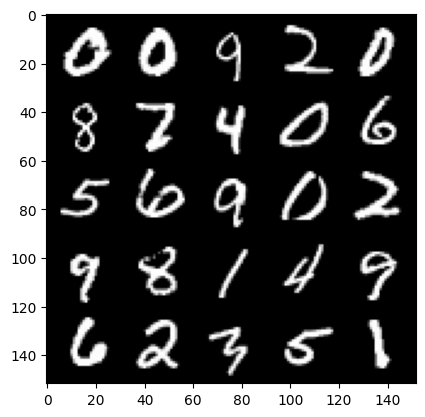

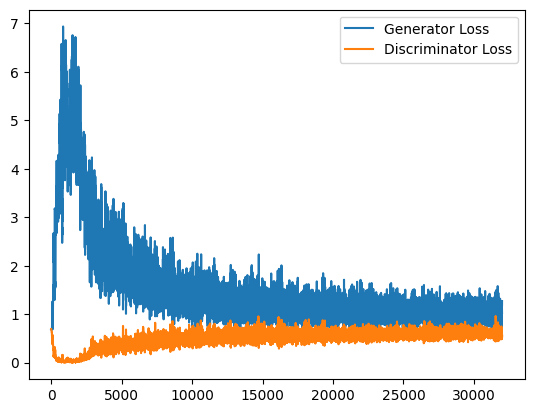

  0%|          | 0/469 [00:00<?, ?it/s]

Step 32500: Generator loss: 0.9930766212940216, discriminator loss: 0.6103947023153306


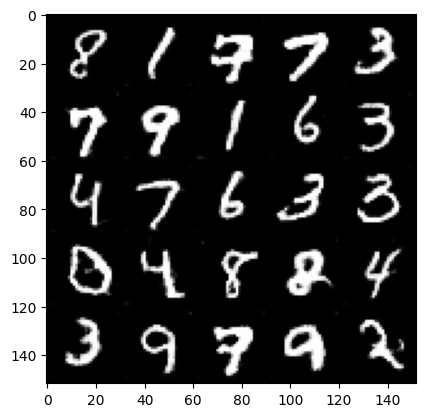

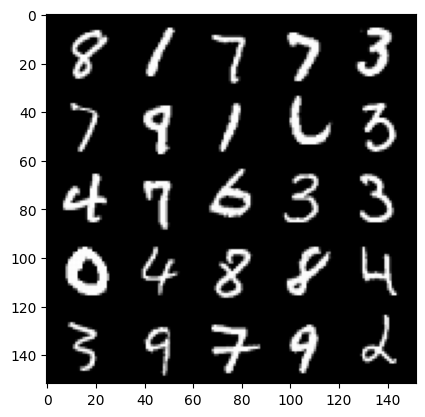

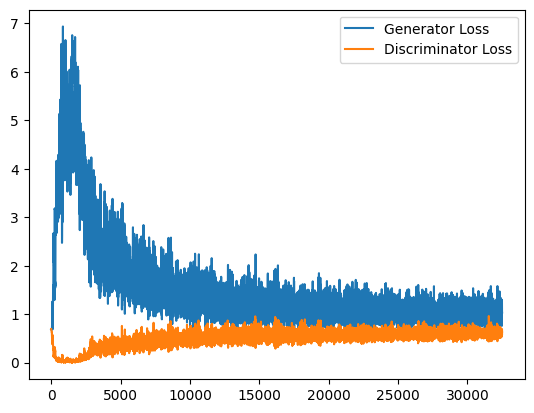

  0%|          | 0/469 [00:00<?, ?it/s]

Step 33000: Generator loss: 1.015910546064377, discriminator loss: 0.6052493203878403


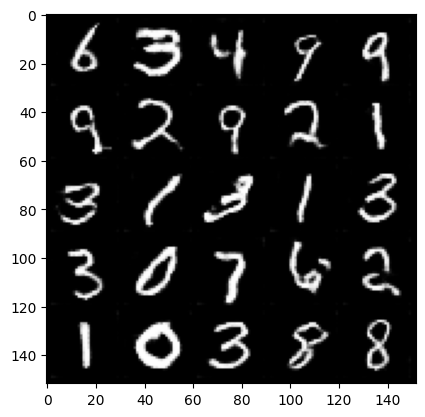

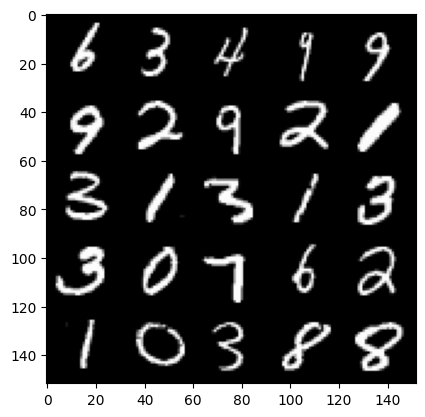

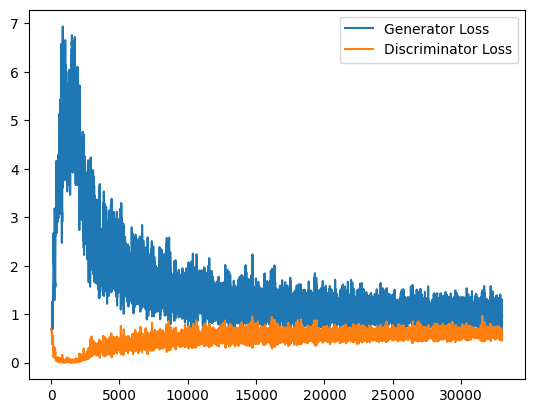

  0%|          | 0/469 [00:00<?, ?it/s]

Step 33500: Generator loss: 0.9784836844205856, discriminator loss: 0.608345555126667


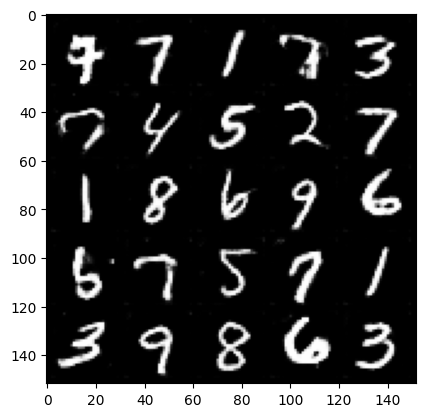

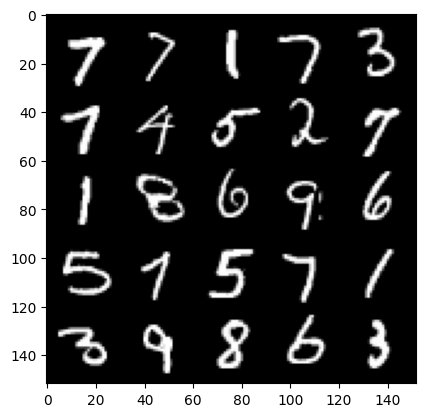

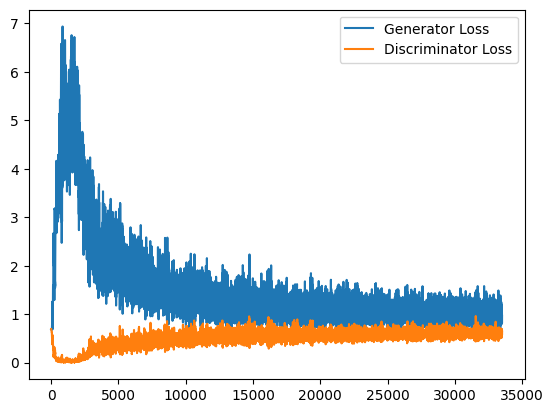

  0%|          | 0/469 [00:00<?, ?it/s]

Step 34000: Generator loss: 0.9572389562129975, discriminator loss: 0.6133167992830276


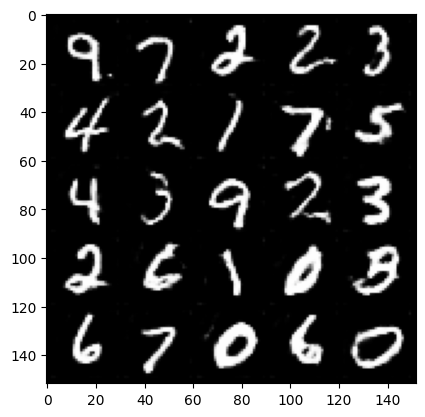

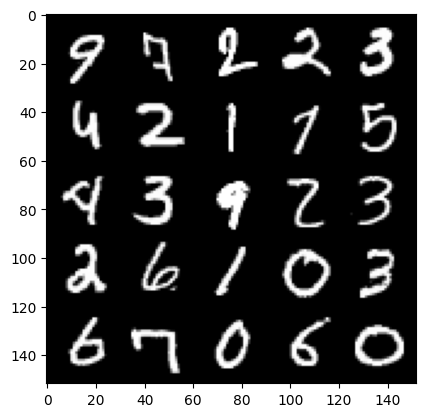

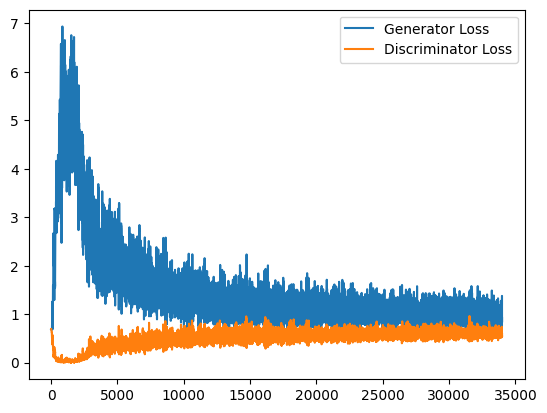

  0%|          | 0/469 [00:00<?, ?it/s]

Step 34500: Generator loss: 0.9900784538984299, discriminator loss: 0.604573047041893


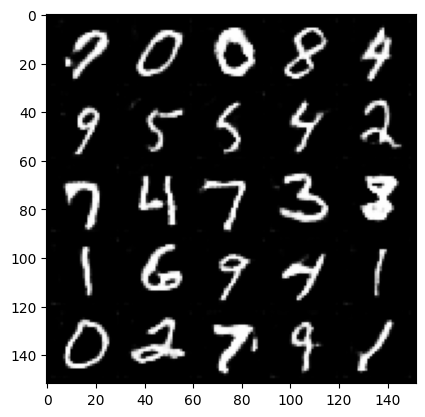

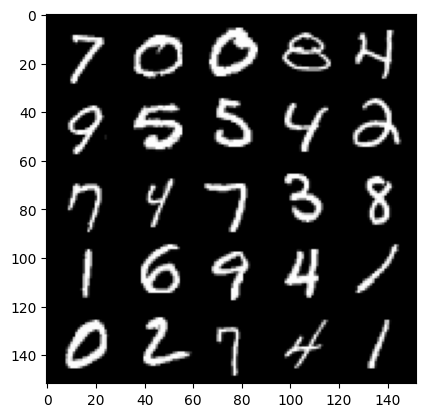

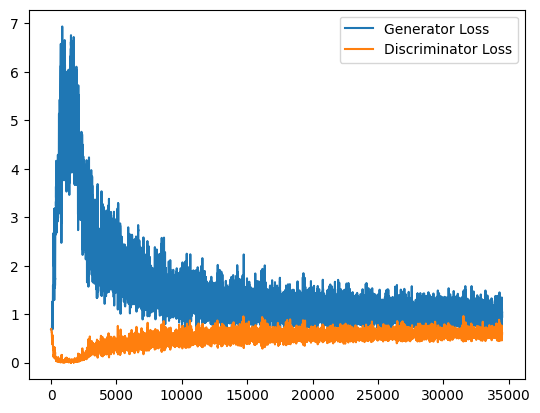

  0%|          | 0/469 [00:00<?, ?it/s]

Step 35000: Generator loss: 0.9742030565738677, discriminator loss: 0.610760520517826


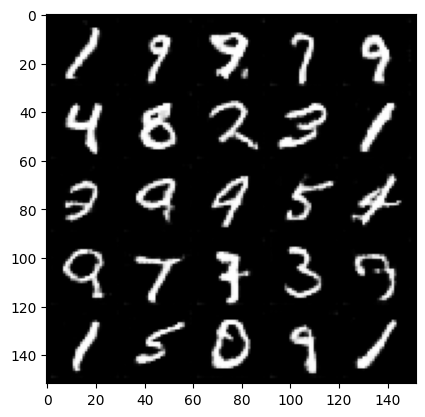

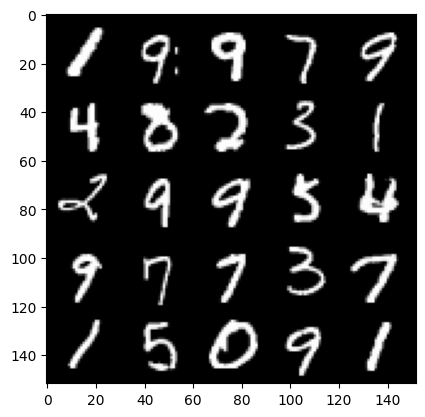

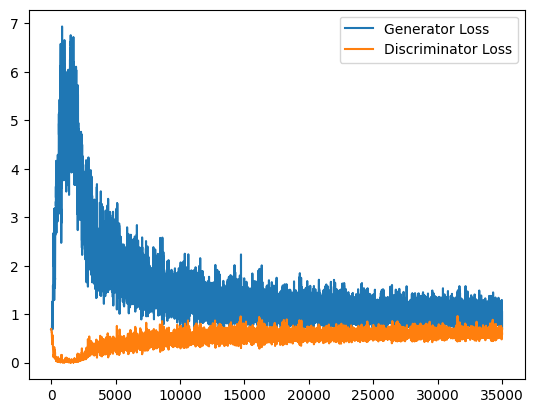

  0%|          | 0/469 [00:00<?, ?it/s]

Step 35500: Generator loss: 1.044309095621109, discriminator loss: 0.619165309727192


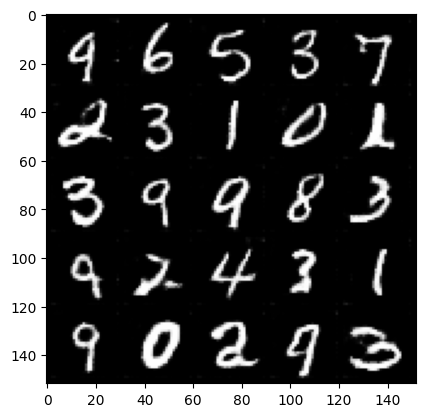

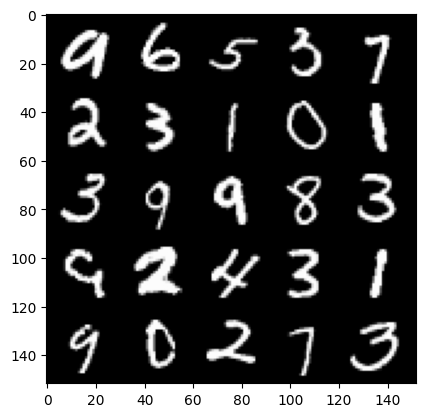

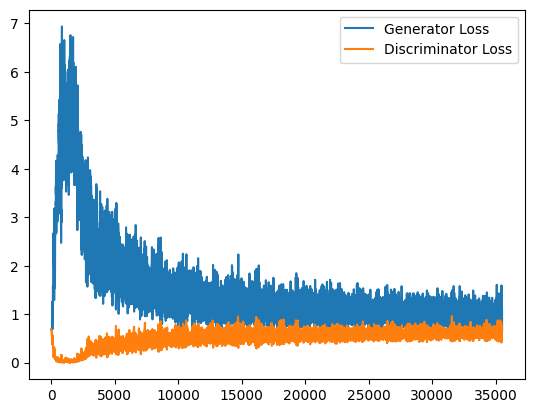

  0%|          | 0/469 [00:00<?, ?it/s]

Step 36000: Generator loss: 0.9836645239591598, discriminator loss: 0.6105673343539239


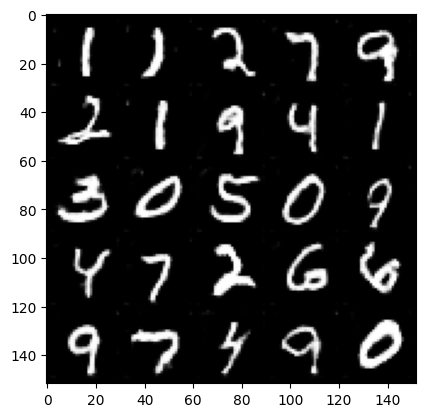

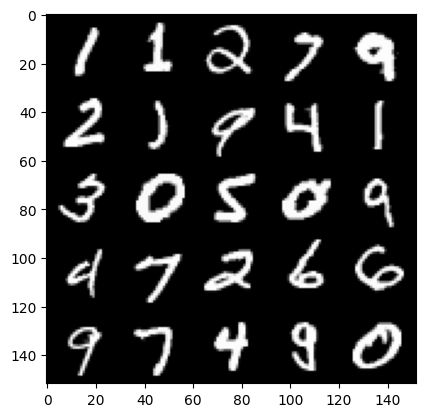

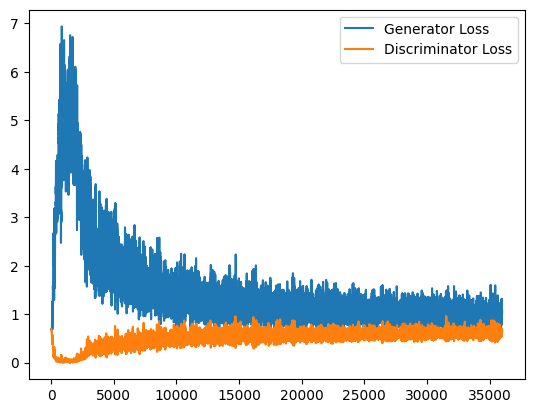

  0%|          | 0/469 [00:00<?, ?it/s]

Step 36500: Generator loss: 0.9924003605842591, discriminator loss: 0.6075294630527497


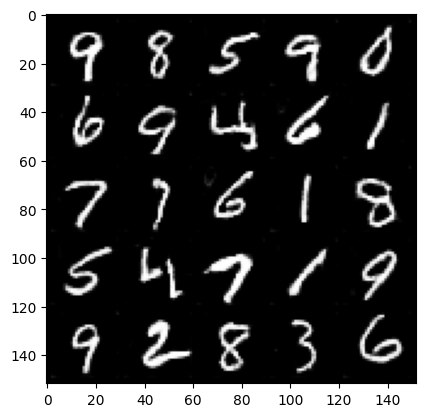

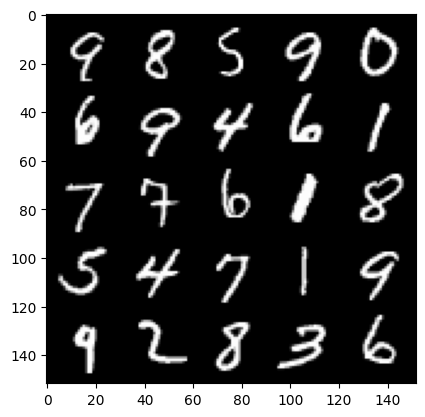

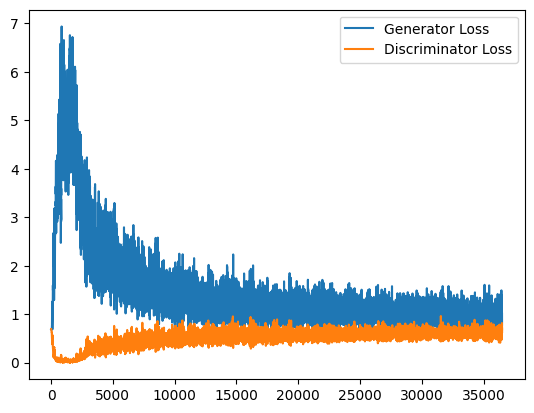

  0%|          | 0/469 [00:00<?, ?it/s]

Step 37000: Generator loss: 0.9756010084152221, discriminator loss: 0.6076950636506081


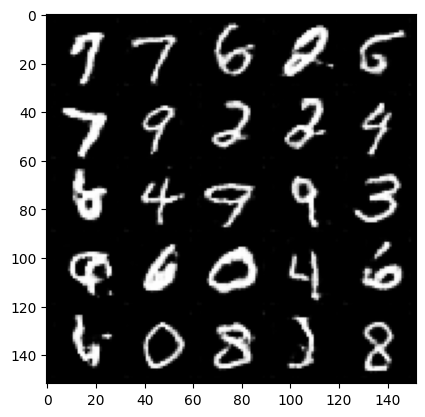

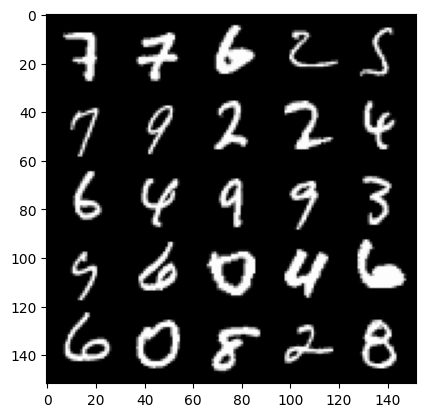

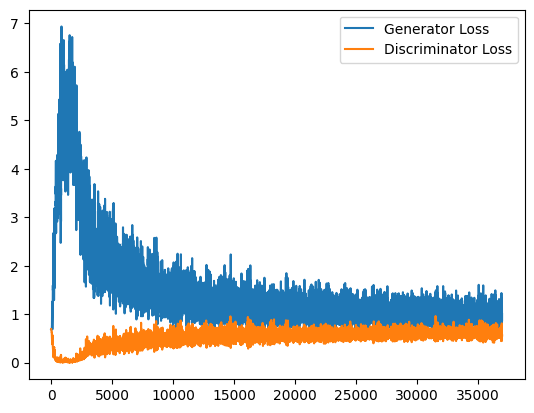

  0%|          | 0/469 [00:00<?, ?it/s]

Step 37500: Generator loss: 0.9830057899951935, discriminator loss: 0.6156831770539284


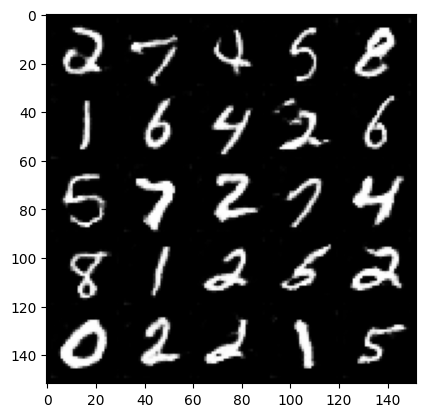

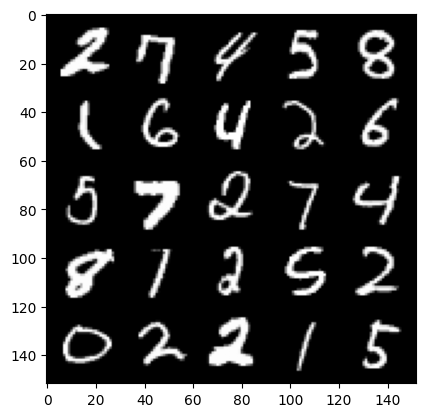

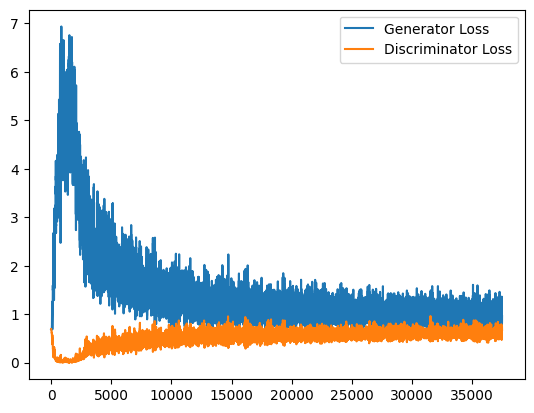

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 38000: Generator loss: 0.9760936018228531, discriminator loss: 0.6104757491350173


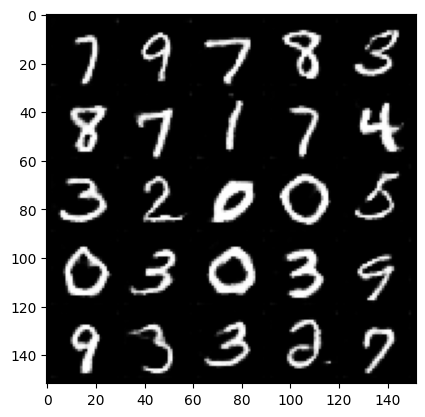

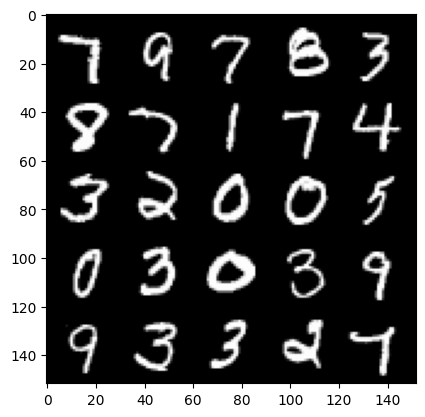

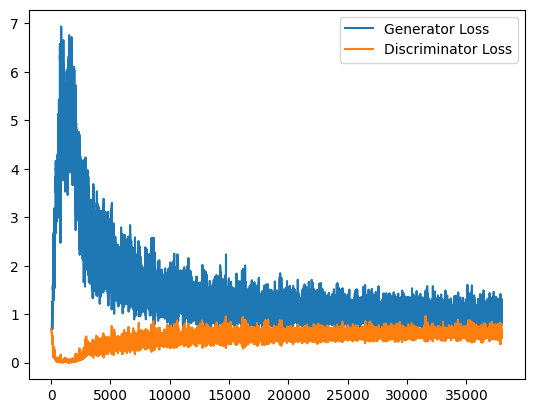

  0%|          | 0/469 [00:00<?, ?it/s]

Step 38500: Generator loss: 0.9880543851852417, discriminator loss: 0.6136090740561485


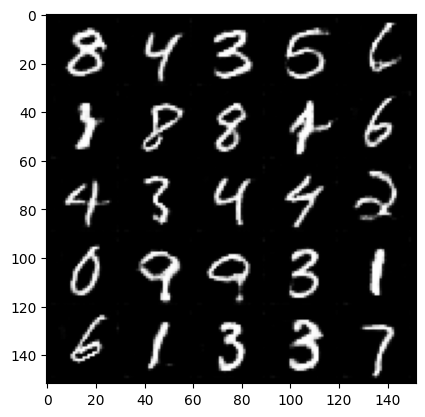

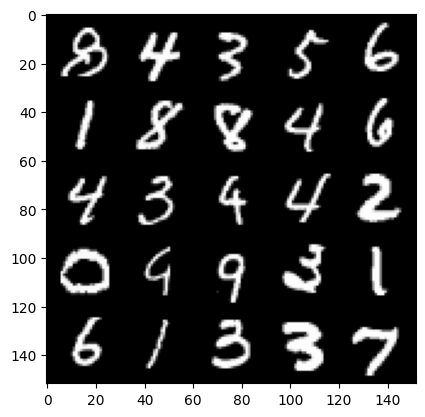

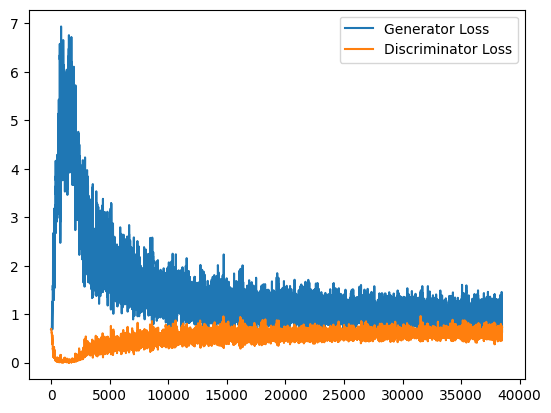

  0%|          | 0/469 [00:00<?, ?it/s]

Step 39000: Generator loss: 0.9839536961317062, discriminator loss: 0.6146034932732583


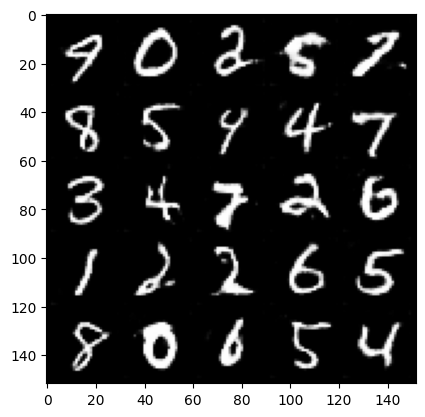

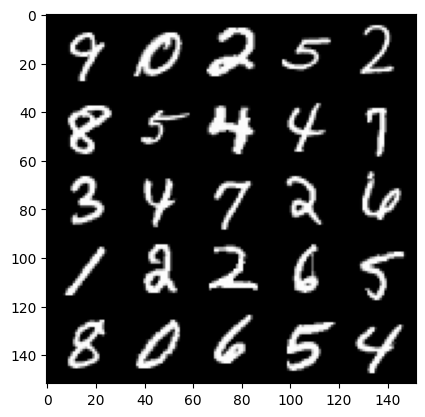

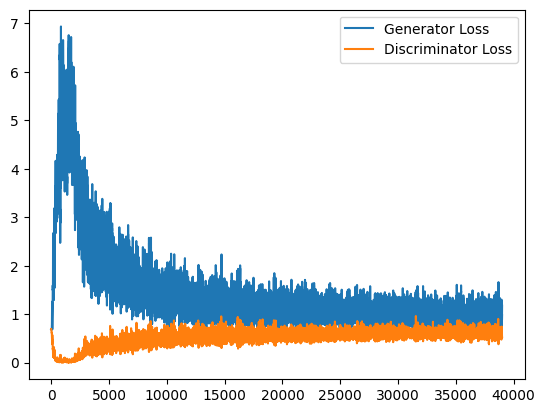

  0%|          | 0/469 [00:00<?, ?it/s]

Step 39500: Generator loss: 0.9417529022693634, discriminator loss: 0.6134265547394753


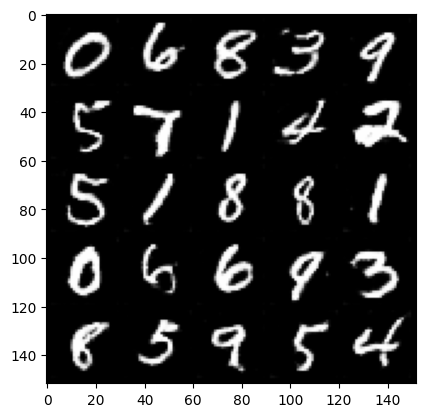

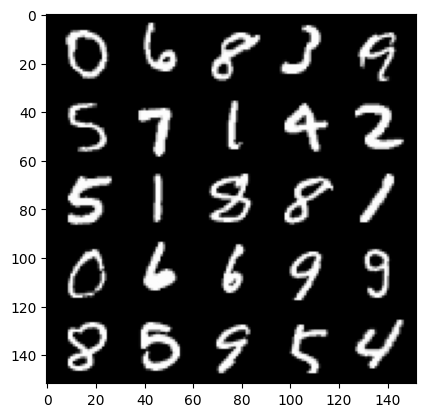

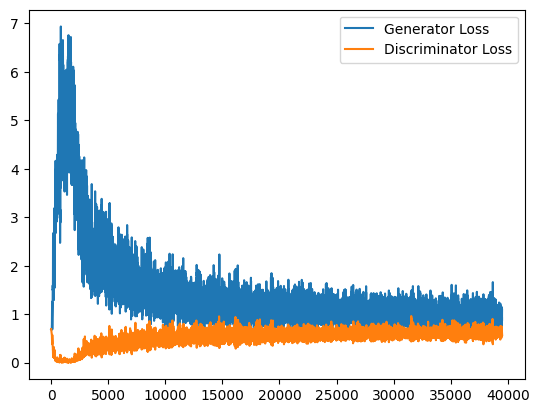

  0%|          | 0/469 [00:00<?, ?it/s]

Step 40000: Generator loss: 0.9751859611272812, discriminator loss: 0.6100150637626648


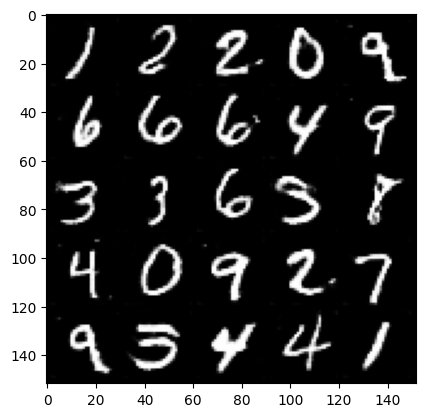

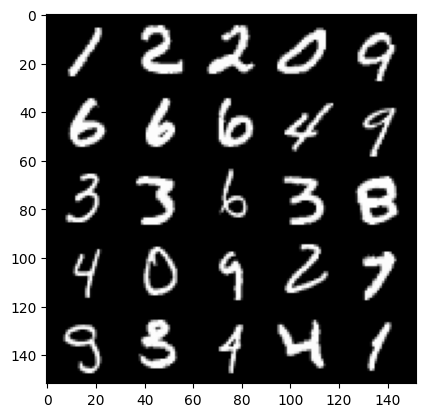

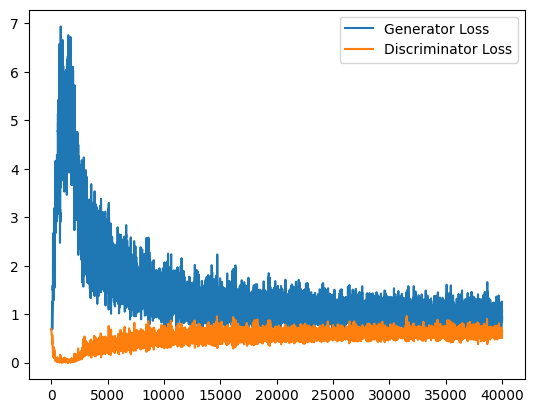

  0%|          | 0/469 [00:00<?, ?it/s]

Step 40500: Generator loss: 1.0013259377479553, discriminator loss: 0.6134356895089149


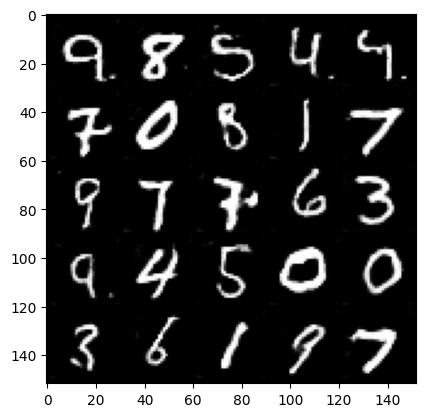

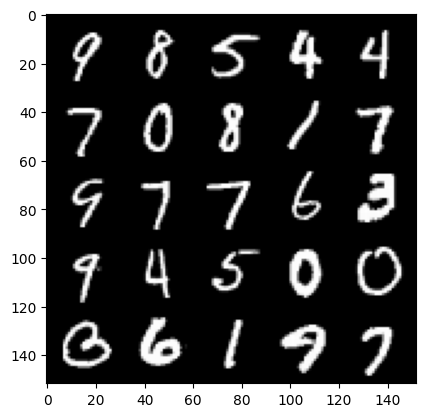

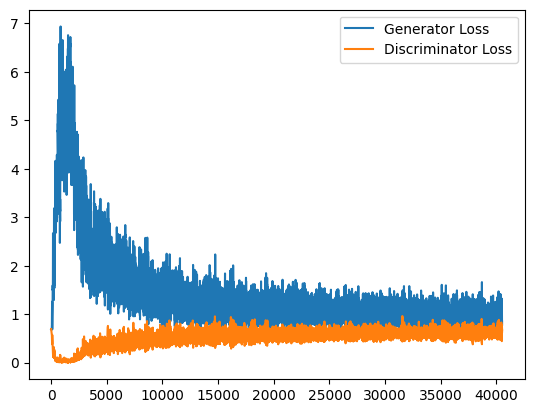

  0%|          | 0/469 [00:00<?, ?it/s]

Step 41000: Generator loss: 0.9662560677528381, discriminator loss: 0.6173994780182839


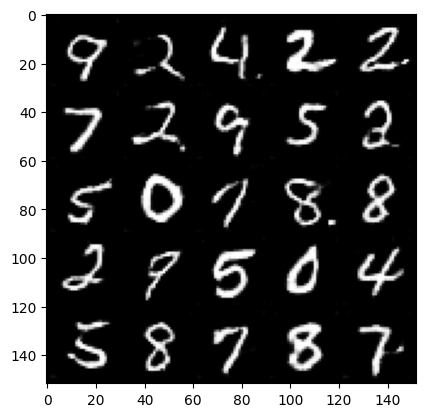

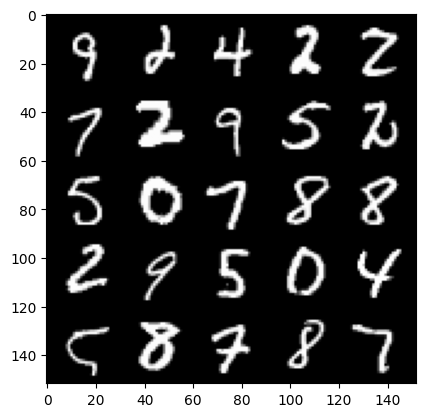

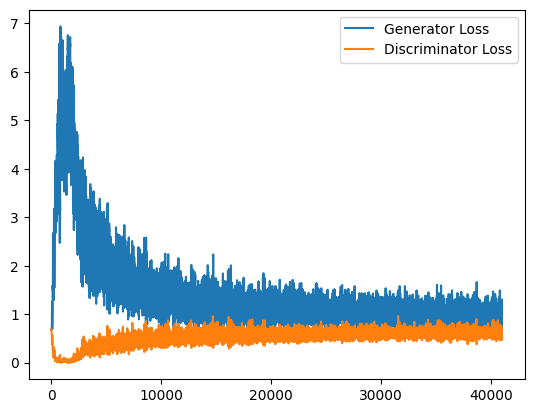

  0%|          | 0/469 [00:00<?, ?it/s]

Step 41500: Generator loss: 0.9541442303657531, discriminator loss: 0.6099778513908386


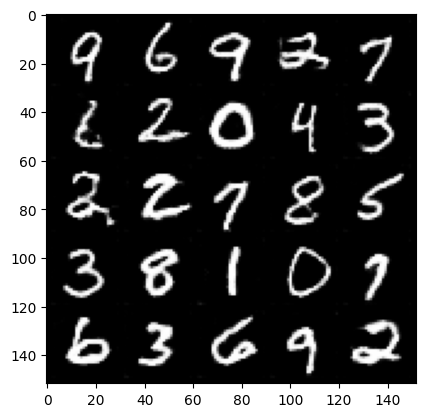

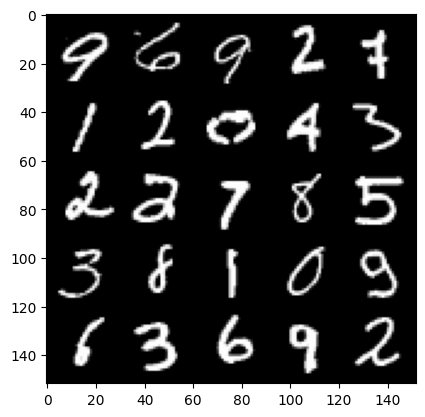

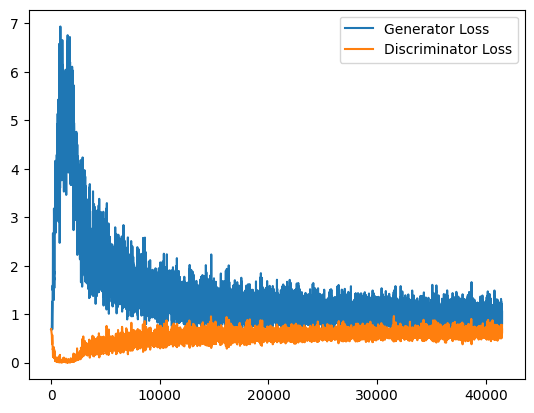

  0%|          | 0/469 [00:00<?, ?it/s]

Step 42000: Generator loss: 0.9745009967088699, discriminator loss: 0.6116732800602913


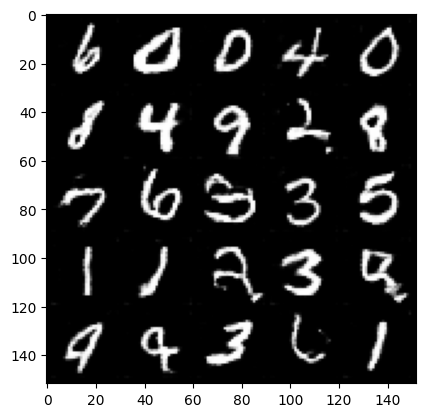

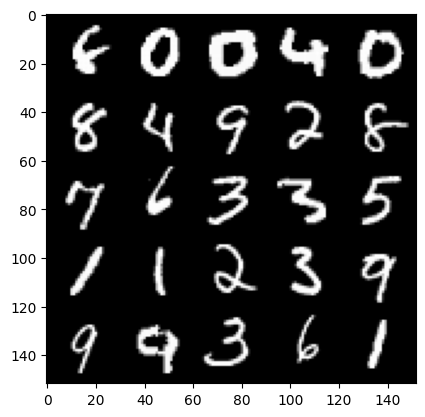

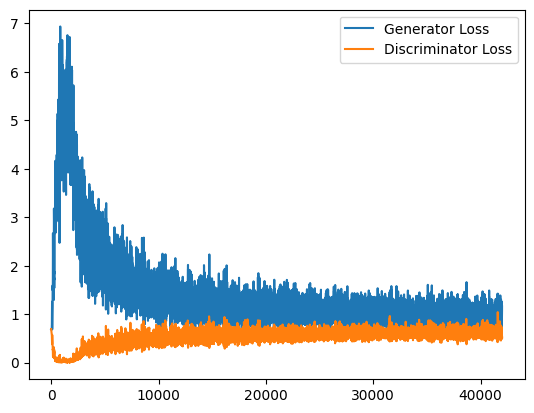

  0%|          | 0/469 [00:00<?, ?it/s]

Step 42500: Generator loss: 0.9726293588876724, discriminator loss: 0.6120056995749473


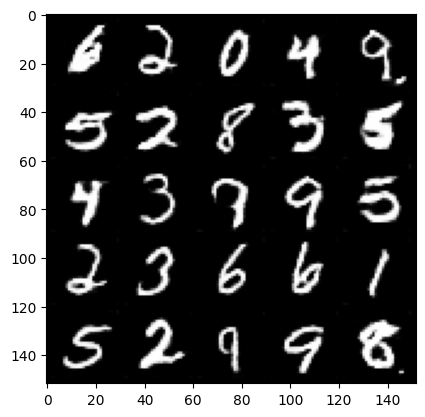

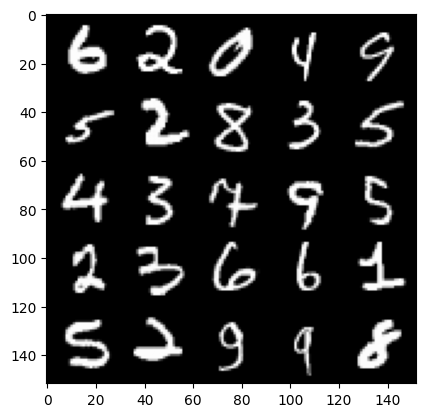

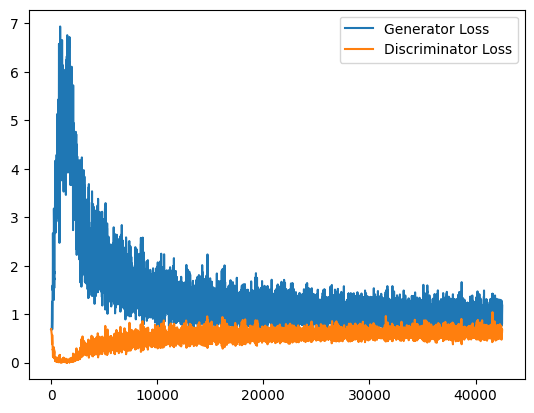

  0%|          | 0/469 [00:00<?, ?it/s]

Step 43000: Generator loss: 0.9888132122755051, discriminator loss: 0.614404157936573


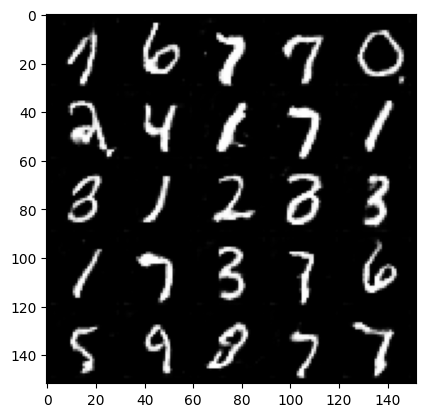

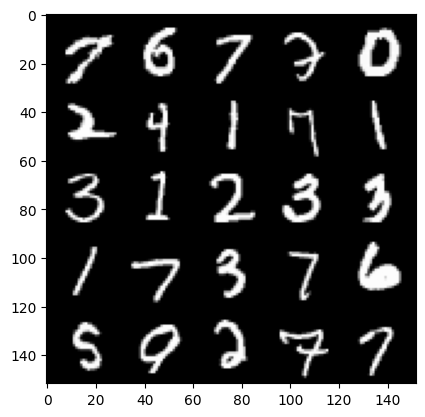

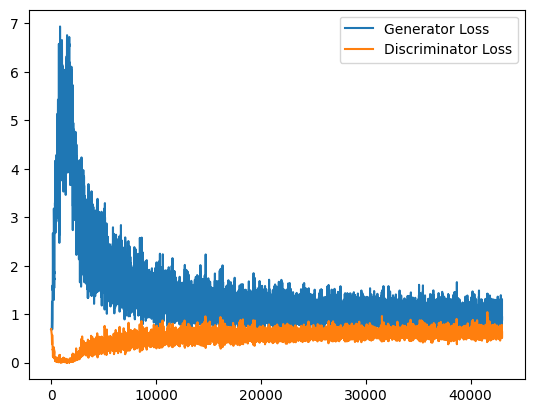

  0%|          | 0/469 [00:00<?, ?it/s]

Step 43500: Generator loss: 0.9562391041517257, discriminator loss: 0.6133644970059395


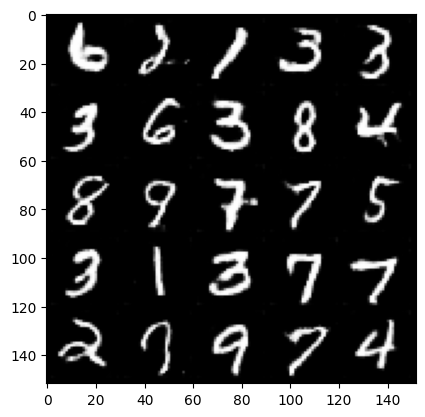

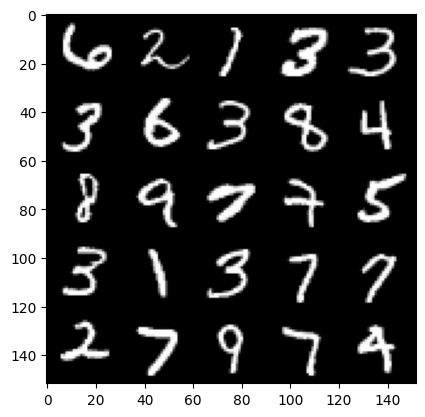

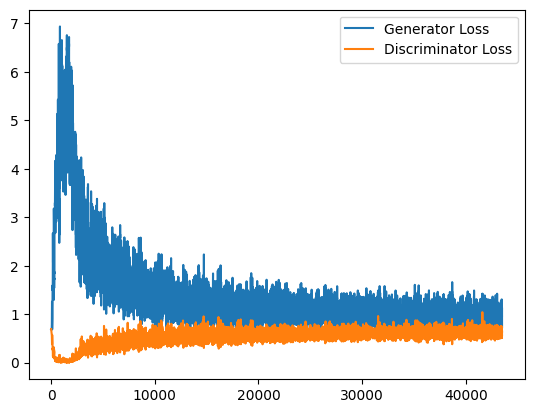

  0%|          | 0/469 [00:00<?, ?it/s]

Step 44000: Generator loss: 0.9573207941055298, discriminator loss: 0.6152233867049217


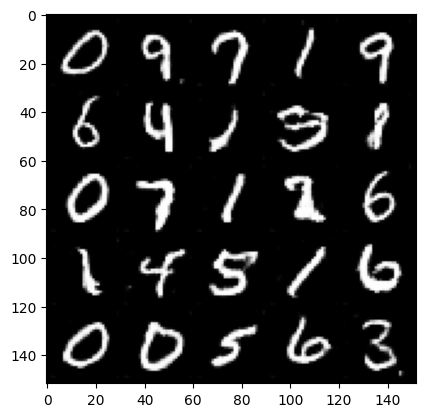

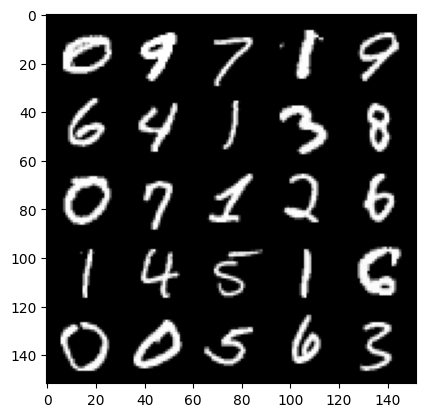

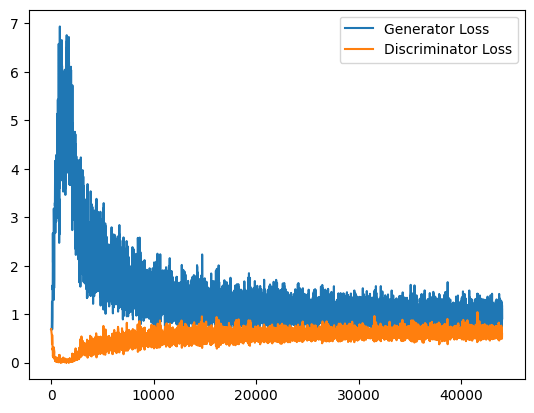

  0%|          | 0/469 [00:00<?, ?it/s]

Step 44500: Generator loss: 0.9538829889297485, discriminator loss: 0.6178896920681


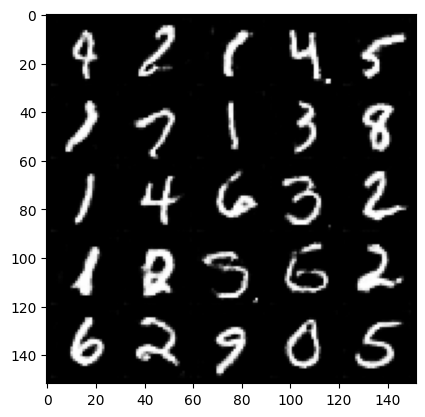

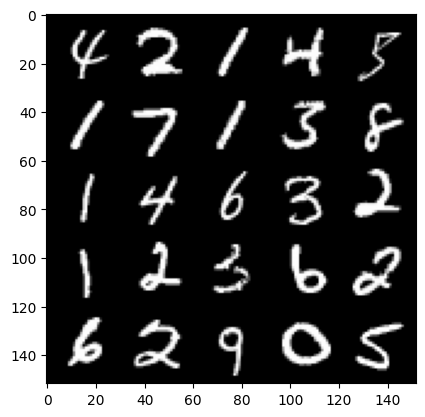

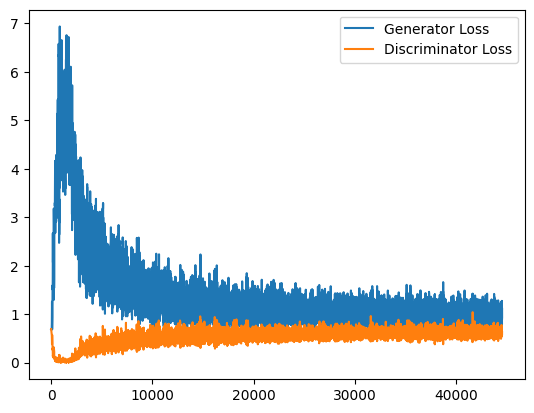

  0%|          | 0/469 [00:00<?, ?it/s]

Step 45000: Generator loss: 0.9646833001375198, discriminator loss: 0.6109171077013016


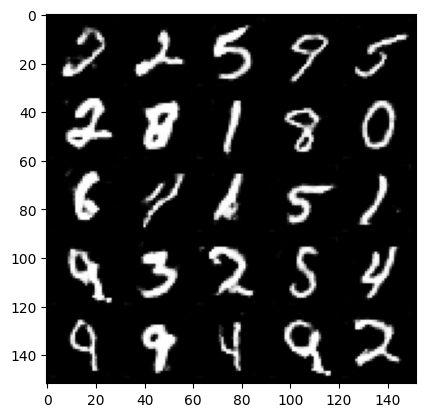

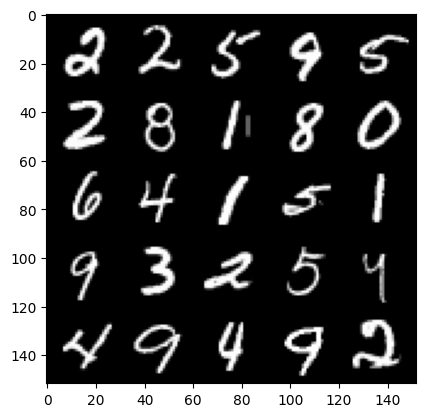

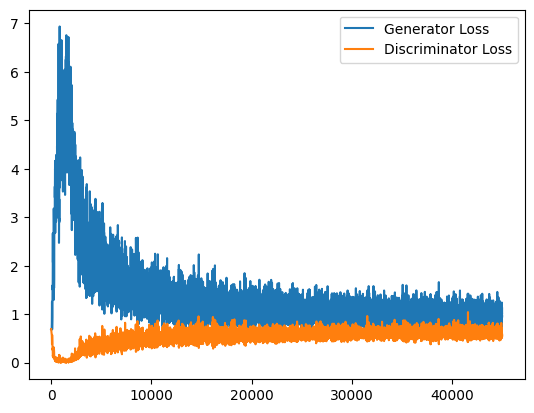

  0%|          | 0/469 [00:00<?, ?it/s]

  0%|          | 0/469 [00:00<?, ?it/s]

Step 45500: Generator loss: 0.9700352768898011, discriminator loss: 0.6196602016687394


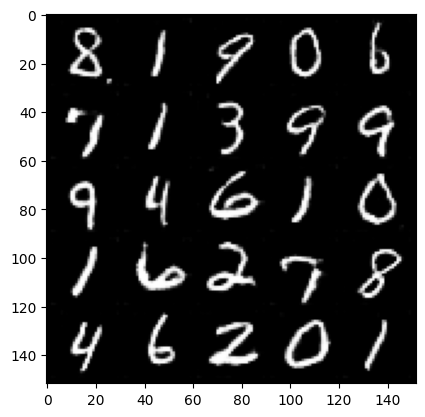

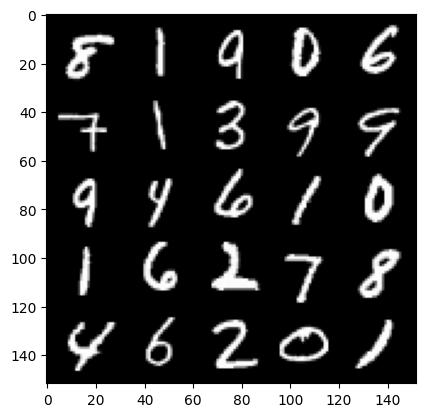

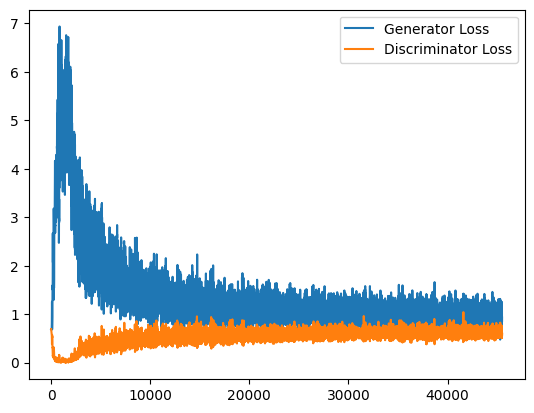

  0%|          | 0/469 [00:00<?, ?it/s]

Step 46000: Generator loss: 0.9661816344261169, discriminator loss: 0.6175232666730881


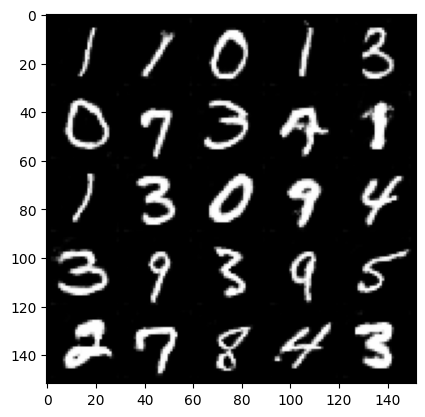

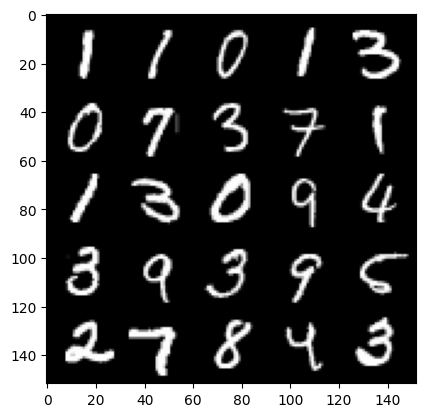

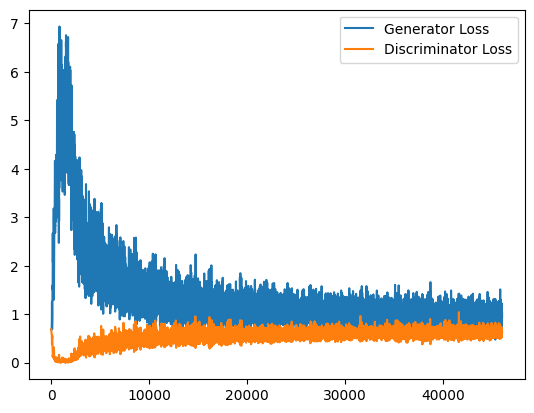

  0%|          | 0/469 [00:00<?, ?it/s]

Step 46500: Generator loss: 0.966298841714859, discriminator loss: 0.6189510182738304


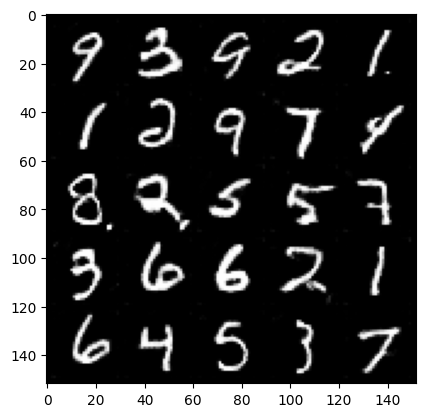

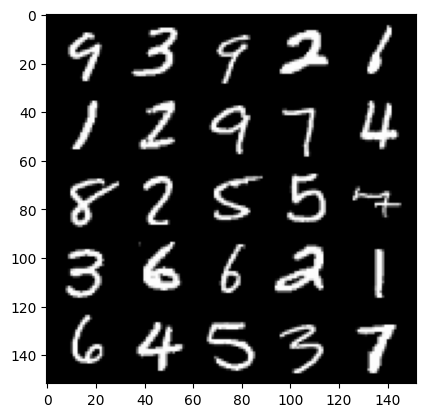

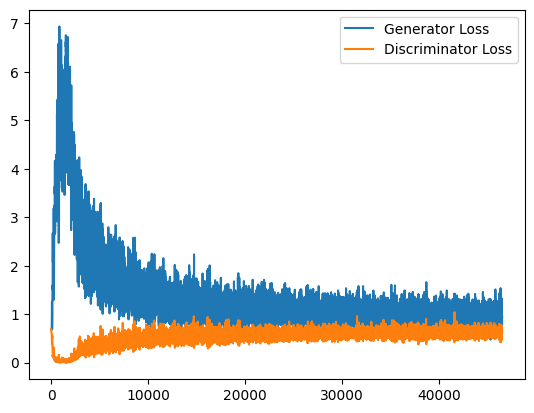

  0%|          | 0/469 [00:00<?, ?it/s]

Step 47000: Generator loss: 0.9461988327503205, discriminator loss: 0.616645831644535


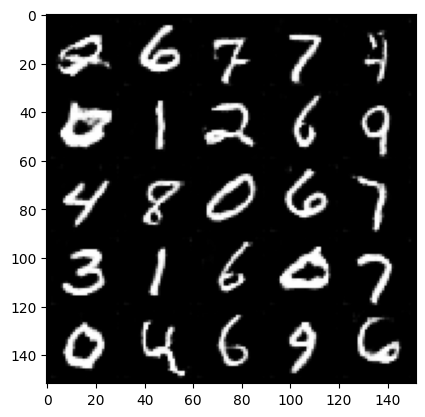

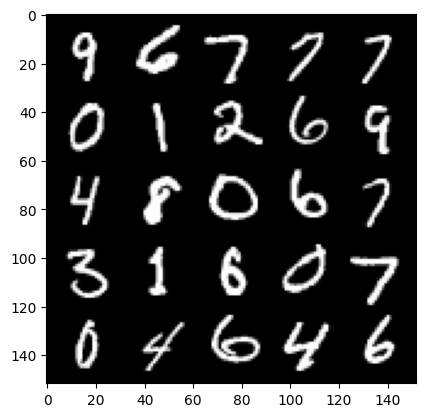

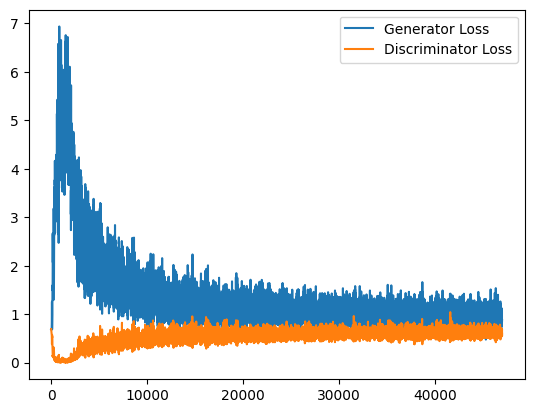

  0%|          | 0/469 [00:00<?, ?it/s]

Step 47500: Generator loss: 0.9678707119226456, discriminator loss: 0.618923730969429


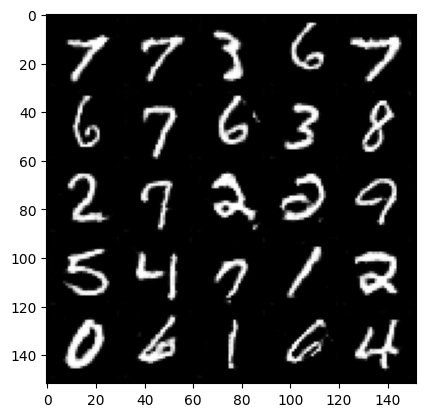

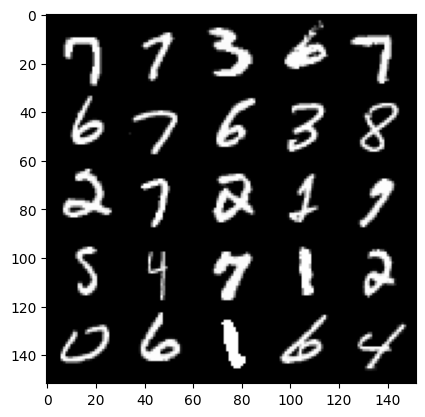

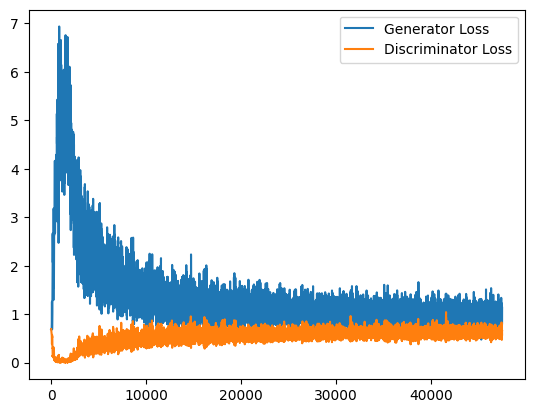

Training stopped after 50.00 minutes.
Models saved successfully.


In [11]:
# cur_step = 0
# generator_losses = []
# discriminator_losses = []

# #UNIT TEST NOTE: Initializations needed for grading
# noise_and_labels = False
# fake = False

# fake_image_and_labels = False
# real_image_and_labels = False
# disc_fake_pred = False
# disc_real_pred = False

# for epoch in range(n_epochs):
#     # Dataloader returns the batches and the labels
#     for real, labels in tqdm(dataloader):
#         cur_batch_size = len(real)
#         # Flatten the batch of real images from the dataset
#         real = real.to(device)

#         one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
#         image_one_hot_labels = one_hot_labels[:, :, None, None]
#         image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

#         ### Update discriminator ###
#         # Zero out the discriminator gradients
#         disc_opt.zero_grad()
#         # Get noise corresponding to the current batch_size
#         fake_noise = get_noise(cur_batch_size, z_dim, device=device)

#         # Now you can get the images from the generator
#         # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
#         #        2) Generate the conditioned fake images

#         #### START CODE HERE ####
#         noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
#         fake = gen(noise_and_labels)
#         #### END CODE HERE ####

#         # Make sure that enough images were generated
#         assert len(fake) == len(real)

#         # Now you can get the predictions from the discriminator
#         # Steps: 1) Create the input for the discriminator
#         #           a) Combine the fake images with image_one_hot_labels,
#         #              remember to detach the generator (.detach()) so you do not backpropagate through it
#         #           b) Combine the real images with image_one_hot_labels
#         #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
#         #        3) Get the discriminator's prediction on the reals as disc_real_pred

#         #### START CODE HERE ####
#         fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
#         real_image_and_labels = combine_vectors(real, image_one_hot_labels)
#         disc_fake_pred = disc(fake_image_and_labels)
#         disc_real_pred = disc(real_image_and_labels)
#         #### END CODE HERE ####

#         # Make sure that enough predictions were made
#         assert len(disc_real_pred) == len(real)
#         # Make sure that the inputs are different
#         assert torch.any(fake_image_and_labels != real_image_and_labels)

#         disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
#         disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
#         disc_loss = (disc_fake_loss + disc_real_loss) / 2
#         disc_loss.backward(retain_graph=True)
#         disc_opt.step()

#         # Keep track of the average discriminator loss
#         discriminator_losses += [disc_loss.item()]

#         ### Update generator ###
#         # Zero out the generator gradients
#         gen_opt.zero_grad()

#         fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
#         # This will error if you didn't concatenate your labels to your image correctly
#         disc_fake_pred = disc(fake_image_and_labels)
#         gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
#         gen_loss.backward()
#         gen_opt.step()

#         # Keep track of the generator losses
#         generator_losses += [gen_loss.item()]
#         #

#         if cur_step % display_step == 0 and cur_step > 0:
#             gen_mean = sum(generator_losses[-display_step:]) / display_step
#             disc_mean = sum(discriminator_losses[-display_step:]) / display_step
#             print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
#             show_tensor_images(fake)
#             show_tensor_images(real)
#             step_bins = 20
#             x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
#             num_examples = (len(generator_losses) // step_bins) * step_bins
#             plt.plot(
#                 range(num_examples // step_bins),
#                 torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
#                 label="Generator Loss"
#             )
#             plt.plot(
#                 range(num_examples // step_bins),
#                 torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
#                 label="Discriminator Loss"
#             )
#             plt.legend()
#             plt.show()
#         elif cur_step == 0:
#             print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
#         cur_step += 1

cur_step = 0
generator_losses = []
discriminator_losses = []

# Set time limit (e.g., 50 to 55 minutes)
start_time = time.time()
time_limit_minutes = 50  # Set your desired time limit
time_limit_seconds = time_limit_minutes * 60

# Training loop
for epoch in range(n_epochs):
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)
        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        disc_opt.zero_grad()
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)

        fake_image_and_labels = combine_vectors(fake.detach(), image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        disc_real_pred = disc(real_image_and_labels)

        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step()
        discriminator_losses.append(disc_loss.item())

        ### Update generator ###
        gen_opt.zero_grad()
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()
        generator_losses.append(gen_loss.item())

        # Display the images and loss every display_step iterations
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            plt.plot(generator_losses, label="Generator Loss")
            plt.plot(discriminator_losses, label="Discriminator Loss")
            plt.legend()
            plt.show()

        # Increment the step counter
        cur_step += 1

        # Check if time limit has been reached
        elapsed_time = time.time() - start_time
        if elapsed_time > time_limit_seconds:
            print(f"Training stopped after {elapsed_time / 60:.2f} minutes.")

            # Save the model before stopping
            torch.save(gen.state_dict(), 'generator_final.pth')
            torch.save(disc.state_dict(), 'discriminator_final.pth')
            print("Models saved successfully.")
            break
    else:
        # Continue outer loop if time not exceeded
        continue
    # Break the outer loop if time limit is exceeded
    break

In [12]:
gen = gen.eval()

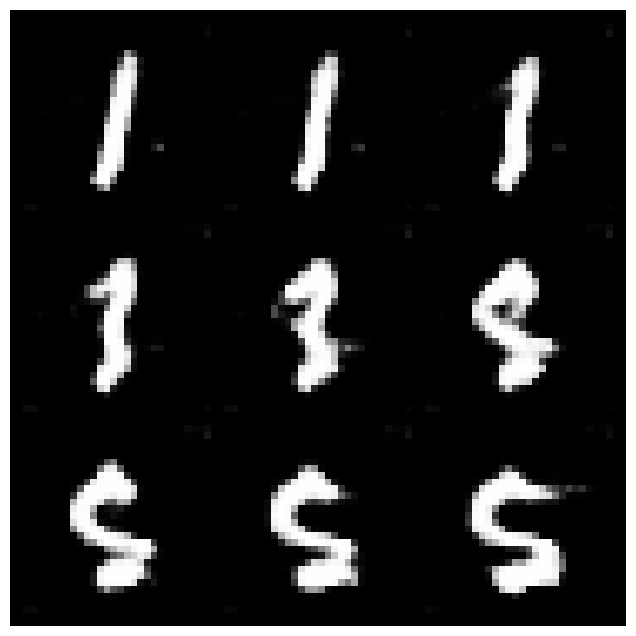

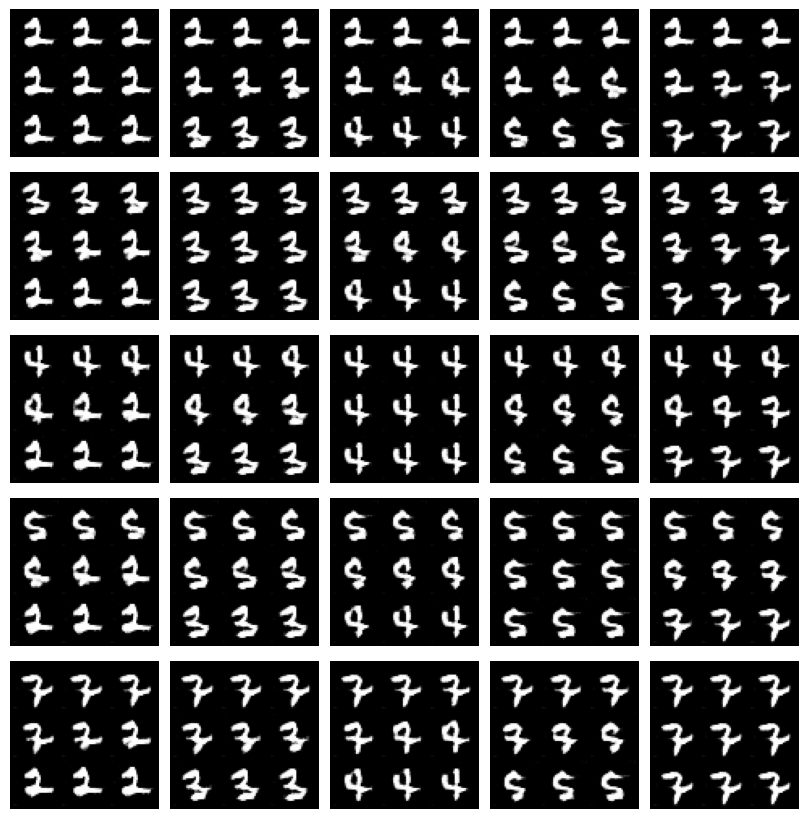

In [13]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
plot_numbers = [2, 3, 4, 5, 7]
n_numbers = len(plot_numbers)
plt.figure(figsize=(8, 8))
for i, first_plot_number in enumerate(plot_numbers):
    for j, second_plot_number in enumerate(plot_numbers):
        plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
        interpolate_class(first_plot_number, second_plot_number)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()

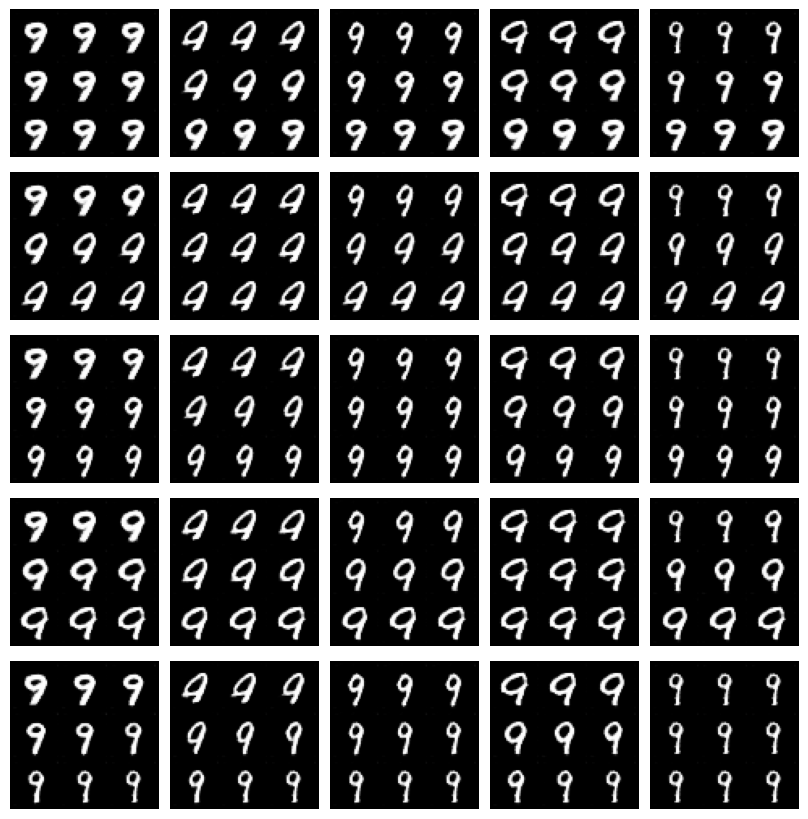

In [18]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([9]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()